## **DM CAFFÈ**
### Análise das operações Maio 2022 a Maio 2023

In [332]:
# jupyter nbconvert --to html --no-input dmcafe_v02.ipynb

In [333]:
from IPython import display
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
# import seaborn as sns; sns.set()
import datetime
import nbformat
import plotly.express as px
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode (connected = True )
import plotly.graph_objs as go
import plotly.offline as py
from matplotlib.backends.backend_pdf import PdfPages
from fpdf import FPDF
pd.options.display.max_columns = None
pd.options.display.max_rows = None
import locale
import plotly.io as pio
from datetime import date
import calendar

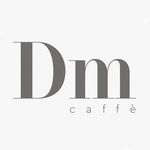

In [334]:
display.Image("/home/claudio/@DM_Cafe/logo/logo_dm_cafe.jpg",width=215)

In [335]:
# setar locale para português para que os dias da semana retornem em portugês no código abaixo.
locale.setlocale(locale.LC_ALL, 'pt_BR.utf-8')

from IPython.display import display, Markdown

# Importing each csv file and then joinning then, 
# as the files for other months are send by the client we can insert each one at the end of this code

df01 = pd.read_excel(r'/home/claudio/@DM_Cafe/documentos/RELATORIOS_POR_HORA/2022 05 - DMCAFFE - Relatório - Vendas - Por hora (1).xlsx')
df02 = pd.read_excel(r'/home/claudio/@DM_Cafe/documentos/RELATORIOS_POR_HORA/2022 06 - DMCAFFE - Relatório - Vendas - Por hora (1).xlsx' )
df03 = pd.read_excel(r'/home/claudio/@DM_Cafe/documentos/RELATORIOS_POR_HORA/2022 07 - DMCAFFE - Relatório - Vendas - Por hora (1).xlsx')
df04 = pd.read_excel(r'/home/claudio/@DM_Cafe/documentos/RELATORIOS_POR_HORA/2022 08 - DMCAFFE - Relatório - Vendas - Por hora (1).xlsx')
df05 = pd.read_excel(r'/home/claudio/@DM_Cafe/documentos/RELATORIOS_POR_HORA/2022 09 - DMCAFFE - Relatório - Vendas - Por hora (1).xlsx')
df06 = pd.read_excel(r'/home/claudio/@DM_Cafe/documentos/RELATORIOS_POR_HORA/2022 10 - DMCAFFE - Relatório - Vendas - Por hora (1).xlsx')
df07 = pd.read_excel(r'/home/claudio/@DM_Cafe/documentos/RELATORIOS_POR_HORA/2022 11 - DMCAFFE - Relatório - Vendas - Por hora (1).xlsx')
df08 = pd.read_excel(r'/home/claudio/@DM_Cafe/documentos/RELATORIOS_POR_HORA/2022 12 - DMCAFEE - Relatório - Vendas - Por hora.xlsx')
df09 = pd.read_excel(r'/home/claudio/@DM_Cafe/documentos/RELATORIOS_POR_HORA/2023 01 - DMCAFEE - Relatório - Vendas - Por hora.xlsx')
df10 = pd.read_excel(r'/home/claudio/@DM_Cafe/documentos/RELATORIOS_POR_HORA/2023 02 - DMCAFFE - Relatório - Vendas - Por hora (1).xlsx')
df11 = pd.read_excel(r'/home/claudio/@DM_Cafe/documentos/RELATORIOS_POR_HORA/2023 03 - DMCAFEE - Relatório - Vendas - Por hora.xlsx')
df12 = pd.read_excel(r'/home/claudio/@DM_Cafe/documentos/RELATORIOS_POR_HORA/2023 04 - DMCAFFE - Relatório - Vendas - Por hora (1).xlsx')
df13 = pd.read_excel(r'/home/claudio/@DM_Cafe/documentos/RELATORIOS_POR_HORA/2023 05 - DMCAFFE - Relatório - Vendas - Por hora (1).xlsx')


In [336]:
transactions = pd.concat([df01, 
df02, df03, df04, df05, df06, df07, df08, df09, df10, df11, df12, df13
                          ], ignore_index=True)

In [337]:
# remove the first row which is not required

transactions = transactions.iloc[1:]

In [338]:
# drop 'Total geral' and 'Total_geral.1' columns
transactions = transactions.drop(columns=['Total geral', 'Total geral.1'])

In [339]:
# creating an empty dataframe
transactions_long = pd.DataFrame()

# iterating through pairs of columns and stacking them
for i in range(2, len(transactions.columns), 2):
    df_temp = transactions.iloc[:, [0, 1, i, i+1]].copy()  # select date, product, value and quantity columns
    df_temp.columns = ['data', 'produto', 'valor', 'quantidade']
    df_temp['hora'] = transactions.columns[i][:5]  # add the hour column

    transactions_long = pd.concat([transactions_long, df_temp])


In [340]:
# drop all the rows that has  a 'NaN' value in both the 'valor' and 'quantidade' from the transactions_long dataframe
transactions_long = transactions_long.dropna(subset=['valor', 'quantidade'], how='all')

# drop all the rows that has  a 'NaN' value in produto from the transactions_long dataframe
transactions_long = transactions_long.dropna(subset=['produto'], how='all')


In [341]:
# drop the rows that have the string total in the 'date' column in the transactions_long datframe
transactions_long['data'] = transactions_long['data'].astype(str)
transactions_long = transactions_long[~transactions_long['data'].str.contains('total', case=False)]

In [342]:
# https://www.w3schools.com/python/pandas/ref_df_reset_index.asp
# Pandas DataFrame reset_index() Method
transactions_long.reset_index(drop= True, inplace=True)

In [343]:
# how to remove a piece of string R$ in the valor column?

transactions_long['valor'] = transactions_long['valor'].apply(lambda x: x.replace('R$ ', ''))

In [344]:
# change the decimal separator of the the variable "valor" from "," to "."
# https://cursos.alura.com.br/forum/topico-transformar-pontos-por-virgulas-dentro-de-um-dataframe-121090
transactions_long['valor'] = transactions_long['valor'].str.replace(",",".", regex=True)

# See Pandas 1.2.0 release notes:
# The default value of regex for Series.str.replace() will change from True to False in a future release. 
# In addition, single character regular expressions will not be treated as literal strings when regex=True is set (GH24804)
# I.e., use regular expressions explicitly now:

In [345]:
# Convert the valor column from string to float type
transactions_long['valor'] = transactions_long['valor'].astype(float)

In [346]:
# how to remove a piece of string '.00' in the quantidade column?
transactions_long['quantidade'] = transactions_long['quantidade'].apply(lambda x: x.replace('.00', ''))

In [347]:
# Convert the quantidade column from string to integer type
transactions_long['quantidade'] = np.int64(transactions_long['quantidade'])

In [348]:
# define a function to format currency values
def format_currency(value):
    return locale.currency(value, grouping=True)

In [349]:
# taking the valor unitário from the 'valor' column as the values provided were the valor unitario of the item multiplied by the quantidade
transactions_long['valor']= transactions_long['valor'] / transactions_long['quantidade']

In [350]:
# renaming the column valor para valor_unit
transactions_long.rename(columns = {'valor':'valor_unit'}, inplace = True)

In [351]:
# converting the data column from string to date_time
transactions_long['data']=pd.to_datetime(transactions_long['data'])

In [352]:
# insert a column name 'mes' 
transactions_long['mes'] = transactions_long.data.dt.month

In [353]:
# insert a column name 'dia_da_semana' 
transactions_long['dia_da_semana'] = [calendar.day_name[i.weekday()] for i in transactions_long['data']]

In [354]:
# insert a column name 'ano_mes' 
transactions_long['ano_mes'] = transactions_long['data'].dt.strftime('%Y-%m')

In [355]:
# em um string quero manter os primeiros dois digitos e descartar o restante
transactions_long['hora'] = transactions_long['hora'].str.slice(0, 2)

In [356]:
# Convert the hora column from string to integer type
transactions_long['hora'] = np.int64(transactions_long['hora'])

In [357]:
# Definindo a função time_of_day
def time_of_day(hora):
    """
    Determina se a  compra foi feita pela manhã, tarde ou noite.
    """
    
    if hora < 12:
        
        return 'manhã'
    
    elif hora < 18:
        
        return 'tarde'
    
    else:
        
        return 'noite'

# create the column 'periodo_do_dia'    
transactions_long['periodo_do_dia'] = transactions_long.hora.apply(time_of_day)

In [358]:
# Add a tipo_de_dia variable (FS= final de semana or DU=  dia útil)
transactions_long['tipo_de_dia'] = ['FS' if (i == 'domingo') | (i == 'sábado') else 'DU' for i in 
                                                                            transactions_long['dia_da_semana']]

In [359]:
# you can use the str.slice method to get the first 5 characters
# then str.replace to remove all non-digit characters
transactions_long['cod_produto'] = transactions_long['produto'].str.slice(0, 5).str.replace(r'\D', '', regex=True)

In [360]:
# TIREI O VALOR DO CÓDIGO DO PRODUTO DA COLUNA PRODUTO JÁ QUE ELE TEM UMA COLUNA SÓ PARA ESSE VALOR
transactions_long['produto'] = transactions_long['produto'].replace(r'^[^a-zA-Z]*', '', regex=True)


In [361]:
# CALCULEI A COLUNA TOTAL_ITEM BASEADA NAS COLUNAS VALOR_UNIT E QUANTIDADE
transactions_long['total_item'] = transactions_long['valor_unit'] * transactions_long['quantidade']

In [362]:
# FILTREI O DF TRANSACTIONS_LONG PARA FICAR SÓ AS LINHAS QUE O VALOR UNITÉRIO ERA INEXSITENTE
daddos_faltantes_01 = transactions_long.loc[pd.isna(transactions_long['valor_unit'])].copy()

In [363]:
#CONVERTI EM STRING A DATA
daddos_faltantes_01['data']=(daddos_faltantes_01['data']).astype(str)

In [364]:
# ORDENEI POR DATA
daddos_faltantes_01 = daddos_faltantes_01.sort_values(by='data')

In [365]:
# FILTREI O MÊS DE ABRIL 2023 PARA FACILITAR A ANÁLISE E COMPARAR COM OS DADOS INICIAIS DO ARQUIVO ENVIADO PELO CLIENTE
dados_faltantes_filtrados = daddos_faltantes_01.loc[daddos_faltantes_01['ano_mes']=='2023-04']

In [366]:
# EXPORTEI PARA UM ARQUIVO DO EXCEL O DATFRAME FILTRADO
dados_faltantes_filtrados.to_excel('/home/claudio/@DM_Cafe/documentos/quantidade_valor_zerados_2023_04.xlsx')

In [367]:
# AGRUPEI OS DADOS FALTANTES POR PRODUTO
daddos_faltantes_01_agrupados = daddos_faltantes_01.groupby('produto').size().reset_index(name='counts')

In [411]:
# Gráfico 00

fig_00 = go.Figure(data=[go.Table(
    header=dict(values=list(['Produto', 'Ocorrências']),
                font=dict(color='white', size=14), # configurando a cor e tamanho da letra
                fill_color='gray',
                align='left'),
    cells=dict(values=[daddos_faltantes_01_agrupados['produto'], daddos_faltantes_01_agrupados['counts']],
               font=dict(color='black', size=12),
               fill_color='lightgray',
               align='left'))
])
fig_00.update_layout(
    title={
        'text': "Ocorrência dos registros que apresentam o valor zero na coluna quantidade",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})

py.iplot(fig_00)

Identificamos que algumas entradas estão sem a informação de quantidade, tornando-as inadequadas para nossa análise. Esses registros, consequentemente, serão excluídos. Esta situação reforça a necessidade de um monitoramento rigoroso das comandas para evitar tais omissões. Infelizmente, 160 entradas tiveram que ser descartadas devido a este problema. Recomendamos práticas mais efetivas de registro para assegurar a qualidade dos dados futuros.

In [406]:
# Grafico 01
fig_01 = go.Figure(data=[go.Table(
    header=dict(values=list(['Data', 'Produto', 'hora', 'Quantidade']),
                font=dict(color='white', size=12), # configurando a cor e tamanho da letra
                fill_color='gray',
                align='left'),
    cells=dict(values=[daddos_faltantes_01['data'], daddos_faltantes_01['produto'], daddos_faltantes_01['hora'], daddos_faltantes_01['quantidade'] ],
              font=dict(color='black', size=12),
               fill_color='lightgray',
               align='left'))
])
fig_01.update_layout(
    title={
        'text': "Itens que apresentam o valor zero na coluna quantidade",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})

py.iplot(fig_01)

In [ ]:
daddos_faltantes_01.to_excel('/home/claudio/@DM_Cafe/documentos/quantidade_e_valor_zerados.xlsx')

In [370]:
# excluindo os registros que não possuem valor na coluna 'valor_unit'
transactions_long = transactions_long.loc[pd.notna(transactions_long['valor_unit'])].reset_index(drop = True).copy()

# **Exploração dos Dados**

### Introdução

O método empregado para a análise dos dados do estabelecimento foi a Análise Exploratória de Dados. Isso envolveu a verificação detalhada do conjunto de dados, identificando áreas onde os dados estavam faltando. Em seguida, validamos a qualidade dos dados adicionados e os estruturamos em segmentos e intervalos de tempo específicos para facilitar a análise de tendências. Procedimentos de limpeza foram aplicados para identificar e tratar outliers e dados faltantes. Para concluir, foram criadas apresentações visuais, a fim de ilustrar nossos achados de maneira clara e concisa.

In [371]:
faturamento = pd.Series(transactions_long['total_item'].sum())

In [372]:
# define a function to format currency values
def format_currency(value):
    return locale.currency(value, grouping=True)

### Observações preliminares

In [373]:
faturamento = float(faturamento)
faturamento_formatado = format_currency(faturamento)
text_0B = f'### O faturamento total do periodo foi de: {faturamento_formatado}'

# display as Markdown
display(Markdown(text_0B))

### O faturamento total do periodo foi de: R$ 189.701,60

### Itens vendidos: os mais pouplares

In [374]:
# Find Unique Values of each item sold in the Column "produto"
# https://www.statology.org/pandas-unique-values-in-column/
# Pandas: get first 10 elements of a series
top_produtos_df = transactions_long.groupby('produto').sum('quantidade').copy()

# print (top_produtos[:20])
### Converting a Series to a dataframe and changing the namee of the column
top_produtos_df = top_produtos_df.sort_values(by='quantidade', ascending= False).reset_index()


# renomear as colunas produto e index
#top_produtos_df.rename(columns = {'produto':'quantidade', 'index':'produto'}, inplace = True)

Abaixo segue uma tabela com o ranking dos produtos mais vendidos, logo depois observamos algumas métricas.

In [407]:
# Gráfico 02

fig_top_produtos = go.Figure(data=[go.Table(
    header=dict(values=list(['Produto', 'Quantidade', 'Total Vendas']),
                font=dict(color='white', size=14), # configurando a cor e tamanho da letra
                fill_color='gray',
                align='left'),
    cells=dict(values=[top_produtos_df['produto'], top_produtos_df['quantidade'], top_produtos_df['total_item']
                       .apply(lambda x: 'R$ ' + locale.format_string('%.2f', x, grouping = True)) 
                         ],
               font=dict(color='black', size=12),
               fill_color='lightgray',
               align='left'))
])


fig_top_produtos.update_layout(
    title={
        'text': "Produtos mais vendidos - (Maio 2022 - Maio 23)",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})

py.iplot(fig_top_produtos)

Os itens adicional, porção extra e evento individual não podem ser identificados.

In [376]:
array00 = ['ADICIONAL', 'PORCAO EXTRA', 'EVENTO INDIVIDUAL']
transactions_nd = transactions_long.loc[transactions_long['produto'].isin(array00)]

In [377]:
transactions_nd_grouped = (transactions_nd.groupby('produto').sum('quantidade')).copy().reset_index()

In [408]:
# Gráfico 03

fig_nd_grouped = go.Figure(data=[go.Table(
    header=dict(values=list(['Produto', 'Quantidade', 'Total Vendido']),
                font=dict(color='white', size=14), # configurando a cor e tamanho da letra
                fill_color='gray',
                align='left'),
    cells=dict(values=[transactions_nd_grouped['produto'], transactions_nd_grouped['quantidade'],transactions_nd_grouped['total_item'].apply(lambda x: 'R$ ' + locale.format_string('%.2f', x, True))  ],
               font=dict(color='black', size=12),
               fill_color='lightgray',
               align='left'))
])


fig_nd_grouped.update_layout(
    title={
        'text': "Produtos indefinidos - (Maio 2022 - Maio 23)",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})

py.iplot(fig_nd_grouped)

RETIREI OS DADOS REFERENTES AO INTENS 'ADICIONAL', 'PORCAO EXTRA', 'EVENTO INDIVIDUAL' DA ANÁLISE, DEVIDO A FALTA DE DESCRIÇÃO DE TAIS ITENS E TAMBÉM A POUCA RELEVÂNCIA NA VENDAS DOS MESMOS COMO OBSERVADO ACIMA.


In [398]:
# RETIREI OS DADOS REFERENTES AO INTENS 'ADICIONAL', 'PORCAO EXTRA', 'EVENTO INDIVIDUAL'
transactions_long_filtrado= transactions_long.loc[~transactions_long['produto'].isin(array00)].copy()

In [399]:
## Get unique names in the "produto" column using Series.unique() 
## https://sparkbyexamples.com/pandas/pandas-count-unique-values-in-column/
num_itens_vend = transactions_long_filtrado.produto.unique().size

text_0A = f'### O número de diferentes itens vendido pelo estabelecimento no período foi: {num_itens_vend}'

# display as Markdown
display(Markdown(text_0A))

### O número de diferentes itens vendido pelo estabelecimento no período foi: 101

In [400]:
# achando a média do numero de itens vendidos por dia
grouped_by_date = pd.DataFrame(transactions_long_filtrado.groupby(by='data')[['quantidade', 'total_item']].sum(numeric_only=True)).reset_index()
formatted_media_itens = grouped_by_date.quantidade.mean().round(2)
formatted_media_itens = locale.format_string('%.2f', formatted_media_itens)
text00 = f'### O número médio de itens vendidos por dia foi: {formatted_media_itens}'


# display as Markdown
display(Markdown(text00))

### O número médio de itens vendidos por dia foi: 47,26

In [401]:
# ...and how that varies by time of day by itens sold

itens_por_periodo = transactions_long_filtrado.groupby(by=['data', 'periodo_do_dia'])['quantidade'].sum().round (decimals=2).copy()
itens_por_periodo = itens_por_periodo.to_frame().reset_index()

itens_por_periodo_grouped_media = itens_por_periodo.groupby(by='periodo_do_dia').mean(numeric_only=True).round(2).reset_index()
itens_por_periodo_grouped_media = itens_por_periodo_grouped_media.sort_values(by='quantidade', ascending=False)

itens_por_periodo_grouped_media = itens_por_periodo_grouped_media.rename(columns={'periodo_do_dia':'Período do dia', 'quantidade': 'Média de Itens'})


In [409]:
# Gráfico 04

fig_nd_grouped_media = go.Figure(data=[go.Table(
    header=dict(values=list(itens_por_periodo_grouped_media.columns),
                font=dict(color='white', size=14), # configurando a cor e tamanho da letra
                fill_color='gray',
                align='left'),
    cells=dict(values=[itens_por_periodo_grouped_media['Período do dia'], itens_por_periodo_grouped_media['Média de Itens'] ],
               font=dict(color='black', size=12),
               fill_color='lightgray',
               align='left'))
])


fig_nd_grouped_media.update_layout(
    title={
        'text': "Médias de itens vendidos por período - (Maio 2022 - Maio 23)",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})

py.iplot(fig_nd_grouped_media)

In [384]:
# ...and how that varies by time of day by revenue

vendas_por_periodo = transactions_long_filtrado.groupby(by=['data', 'periodo_do_dia'])['total_item'].sum().round (decimals=2).copy()


In [385]:

vendas_por_periodo = vendas_por_periodo.to_frame().reset_index()


In [386]:

vendas_por_periodo_grouped_media = vendas_por_periodo.groupby(by='periodo_do_dia').mean(numeric_only=True).round(2).reset_index()


In [387]:

vendas_por_periodo_grouped_media = vendas_por_periodo_grouped_media.sort_values(by='total_item', ascending=False)


In [388]:

vendas_por_periodo_grouped_media = vendas_por_periodo_grouped_media.rename(columns={'periodo_do_dia':'Período do dia', 'total_item': 'Faturamento Médio'})


In [403]:
soma_vendas = vendas_por_periodo_grouped_media.sum(numeric_only=True).values[0]
formatted_soma_vendas = 'R$ ' + locale.format_string('%.2f',(soma_vendas), True)
text01 = f'### O valor médio de vendas por dia é: {formatted_soma_vendas}'

# display as Markdown
display(Markdown(text01))

### O valor médio de vendas por dia é: R$ 637,24

In [410]:
# Gráfico 05

fig_nd_vendas_grouped_media = go.Figure(data=[go.Table(
    header=dict(values=list(vendas_por_periodo_grouped_media.columns),
                font=dict(color='white', size=14), # configurando a cor e tamanho da letra
                fill_color='gray',
                align='left'),
    cells=dict(values=[vendas_por_periodo_grouped_media['Período do dia'], vendas_por_periodo_grouped_media['Faturamento Médio'].apply(lambda x: 'R$ ' + locale.format_string('%.2f', x, True)) ],
               font=dict(color='black', size=12),
               fill_color='lightgray',
               align='left'))
])


fig_nd_vendas_grouped_media.update_layout(
    title={
        'text': "Faturamento médio por período - (Maio 2022 - Maio 23)",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})

py.iplot(fig_nd_vendas_grouped_media)

In [391]:
A aprtir daqui é do LOCA

SyntaxError: invalid syntax (344955951.py, line 1)

In [ ]:
# GRAFICO 02
# Creating an frequencie line

Após estas observações iniciais, identificamos que os principais produtos do estabelecimento são os couverts, seguidos pelo Bolinho Acostelado e as cervejas. Dado o amplo leque de itens disponíveis (283), há uma grande variedade entre eles. Notamos que alguns produtos alcançam vendas na casa dos milhares, enquanto outros têm vendas unitárias. A quantidade média de itens vendidos por pedido também é elevada (8,60), sugerindo que, em geral, as mesas são ocupadas por duas ou mais pessoas. No entanto, durante o período da madrugada, observamos uma média de apenas 2,99 itens por pedido, indicando que as mesas tendem a ser ocupadas por um ou dois indivíduos durante essas horas.

 <h2> Quantidade de itens vendidos por dia ao longo do perído analisado</h2>

In [ ]:
# Sales trend by date
# https://www.youtube.com/watch?v=Xjm7fOw6gjY
# use reset index for transforming the data in a variable not a index

grouped_by_date = pd.DataFrame(transactions.groupby(by=['data','dia_da_semana'])['quantidade'].sum().reset_index())


In [ ]:

vendas = px.line(grouped_by_date, x = 'data', y = 'quantidade', hover_data=["dia_da_semana"],
                 title = 'Itens vendidos por dia - Jul/22 a Jan/23<br />', labels= {'quantidade' : 'Quantidade','data': 'Data'})

# update line color
vendas.update_traces(line_color='black')

# update backgournd
vendas.update_layout(
    plot_bgcolor='lightgray', 
    xaxis =dict(mirror=True,
    ticks='outside', showline=True, linecolor='black', gridcolor='white'),
    yaxis =dict(mirror=True, ticks='outside', showline=True, linecolor='black', gridcolor='white')
)



py.iplot(vendas)

Ao examinarmos o gráfico acima, percebemos uma flutuação significativa nas vendas ao longo da semana, com picos nas sextas e sábados e uma diminuição nos demais dias, sobretudo aos domingos. À medida que o tempo avança, essa disparidade se acentua ainda mais, pois nos dias de vendas mais altas registramos níveis quase sempre superiores a quinhentos itens vendidos, bem acima da média de 226,58. Notavelmente, no mês de janeiro, os dias de menor movimento conseguiram manter um nível de vendas acima de 80 itens, o que é bastante positivo, embora ainda haja uma diferença substancial em relação aos dias de maior movimento.

## O impacto da Copa do Mundo de 2022 no faturamento do estabelecimento
### 20 de Novembro de 2022 a 18 de Dezembro de 2022

In [ ]:
# Gráfico 03
# determinando as vendas durante a copa do mundo

# dias da copa do mundo : 20 novembro a 18 de dezembro 2022


vendas = px.line(grouped_by_date, x = 'data', y = 'quantidade', hover_data=["dia_da_semana"],
                 title = 'Venda de itens durante a copa do mundo<br />destacando os jogos da Seleção brasileira na Copa do Mundo', labels= {'quantidade' : 'Quantidade','data': 'Data'},
                 range_x=['2022-11-18','2022-12-20'])


# update line color
vendas.update_traces(line_color='black')

# update backgournd
vendas.update_layout(
    plot_bgcolor='lightgray', 
    xaxis =dict(mirror=True,
    ticks='outside', showline=True, linecolor='black', gridcolor='white'),
    yaxis =dict(mirror=True, ticks='outside', showline=True, linecolor='black', gridcolor='white')
)

# adicionando anaotação
# https://plotly.com/python/styling-plotly-express/
vendas.add_annotation( # add a text callout with arrow
    text="1° jogo", x="2022-11-24", y=200, arrowhead=1, showarrow=True)
vendas.add_annotation( # add a text callout with arrow
    text="2° jogo", x="2022-11-28", y=160, arrowhead=1, showarrow=True)
vendas.add_annotation( # add a text callout with arrow
    text="3° jogo", x="2022-12-02", y=305, arrowhead=1, showarrow=True)
vendas.add_annotation( # add a text callout with arrow
    text="4° jogo", x="2022-12-05", y=90, arrowhead=1, showarrow=True)
vendas.add_annotation( # add a text callout with arrow
    text="5° jogo", x="2022-12-09", y=170, arrowhead=1, showarrow=True)
vendas.add_annotation( # add a text callout with arrow
    text="Inicio<br /> da Copa", x="2022-11-20", y=25, arrowhead=4, showarrow=True)
vendas.add_annotation( # add a text callout with arrow
    text="Final<br /> da Copa", x="2022-12-18", y=25, arrowhead=4, showarrow=True)

py.iplot(vendas)

In [ ]:
# criar um dataframe comparando os números antes, durante e pós copa

grouped_by_date_copa = grouped_by_date.copy()
grouped_by_date_copa['timestamp'] = grouped_by_date_copa['data'].apply(lambda x: pd.Timestamp(x)).copy()


In [ ]:
# Define the date thresholds
pre_copa_date = pd.Timestamp('2022-11-20')
post_copa_date = pd.Timestamp('2022-12-18')

# Create the 'copa' column based on the date conditions
grouped_by_date_copa['copa'] = grouped_by_date_copa['timestamp'].apply(
    lambda x: 'pré-copa' if x < pre_copa_date else ('durante a copa' if pre_copa_date <= x <= post_copa_date else 'pós-copa')
).copy()

In [ ]:
vendas_copa= grouped_by_date_copa.groupby('copa')['quantidade'].mean().round (decimals=2)
vendas_copa = vendas_copa.to_frame().reset_index().copy()
vendas_copa.rename(columns ={'copa': 'Período', 'quantidade':'Média'}, inplace=True)

print('A média de itens vendidos antes, durante e após a copa foi: \n{0}'.format(vendas_copa.sort_values(by=['Média'],ascending=False)))

A média de itens vendidos antes, durante e após a copa foi: 
          Período   Média
2        pós-copa  320.26
0  durante a copa  210.78
1        pré-copa  196.07


In [ ]:
# só para dar espaço

Durante a Copa do Mundo, notamos que a venda média de itens foi ligeiramente superior ao período anterior ao evento, mas significativamente inferior à média de vendas após a Copa. Nos dias de jogos da seleção brasileira, verificamos que as vendas ficaram abaixo do normal, especialmente nas sextas-feiras. A grande final, que ocorreu em um domingo, também apresentou uma queda expressiva nas vendas, o que era esperado dada a tendência habitual desse dia da semana. No entanto, ao considerarmos o evento como um todo, o faturamento não exibiu uma queda marcante. De fato, houve um leve aumento quando comparado ao período anterior à Copa.

In [ ]:
# criamos a variável/coluna 'mes_ano' no dataframe transactions
transactions['mes_ano'] = transactions['data_venda'].dt.strftime('%Y-%m')

## Evolução do faturamento

In [ ]:
# criamos o daaframe fatura_grouped_by_month, utilizando o parametro .copy

fatura_grouped_by_month = transactions.groupby(['mes_ano']).agg({"total_item":sum,'quantidade':sum}).reset_index().copy()

#This code snippet groups the transactions DataFrame by the 'month' column and then aggregates the 'quantidade' field using the sum #function. Let's break it down line by line:

#grouped_by_month = transactions.groupby('month'): This line of code uses the groupby method of the pandas DataFrame to group the #rows of transactions based on the unique values in the 'month' column. This creates a GroupBy object, which is a special pandas #object that can be used for aggregation and transformation tasks on the grouped data.

#grouped_by_month.agg({'quantidade': 'sum'}): This line of code uses the agg method of the GroupBy object, which allows you to #apply aggregation functions on one or more columns of the grouped data. The agg method takes a dictionary as input, where the keys #are the column names to be aggregated, and the values are the aggregation functions to be applied. In this case, the dictionary
#{'quantidade': 'sum'} tells pandas to aggregate the 'quantidade' column using the 'sum' function. This will compute the sum of the #'quantidade' values for each group of rows that share the same value in the 'month' column.

#As a result, the code snippet creates a new DataFrame, grouped_by_month, which contains the sum of the 'quantidade' field for each #unique value in the 'month' column.

In [ ]:
fatura_grouped_by_month['faturamento_mes']= fatura_grouped_by_month['total_item'].apply(lambda x: locale.currency(x, grouping=True)).copy()

# chatgpt sugested code 
# https://stackabuse.com/format-number-as-currency-string-in-python/

In [ ]:
# Gráfico 04

fig_02_go = go.Figure([go.Bar (x=fatura_grouped_by_month['mes_ano'], y=fatura_grouped_by_month['total_item'],customdata=fatura_grouped_by_month['quantidade'],
            marker_color="black", text= fatura_grouped_by_month['faturamento_mes'], hovertemplate ='Quant. itens:<br> %{customdata}<extra></extra>'
        )])
fig_02_go.add_annotation(x = '2022-08', y = 160000, text = '', 
                         showarrow= False)

# add the R$ symbol and thounsand delimiter
# https://stackoverflow.com/questions/58140143/add-currency-symbol-in-the-y-axis-scale-using-plotly-method-in-python
fig_02_go.update_layout(plot_bgcolor='lightgray', 
                        yaxis_tickprefix = 'R$', yaxis_tickformat = ',.2f', title = 'Faturamento Mensal<br />Jul/22 a Jan/23', 
                        xaxis = dict(title = ''),
                        yaxis = dict(visible= False, title = 'Faturamento'))

    
   # xaxis =dict(mirror=True, ticks='outside', showline=True, linecolor='black', gridcolor='lightgray'),
    # yaxis =dict(visible= False, mirror=True, ticks='outside', showline=True, linecolor='black', gridcolor='lightcyan')



fig_02_go.show()


Observamos uma tendência clara de aumento nas vendas ao longo do período, destacando-se particularmente o mês de janeiro de 2023, que apresentou um aumento de quase 80% nas vendas em relação a agosto de 2022, o primeiro mês completo de vendas. Novembro de 2022 apresentou uma variação modesta em relação a outubro, o que foi notável, dado que mês a mês o estabelecimento vinha demonstrando um crescimento expressivo. No entanto, isso pode ser explicado, conforme discutido anteriormente, pela ocorrência da Copa do Mundo de futebol, que levou muitos dos clientes habituais a permanecerem em suas residências para acompanhar o evento. Já dezembro revelou um aumento expressivo nas vendas.

# Analisando a venda de itens

Agora iremos analisar mais detalhadamente a distribuição na venda de cada item proporcionalmente as vendas totais

In [ ]:
# find the percentage each item is selling
top_produtos_perc = transactions.produto.value_counts(True)
# print (top_produtos_perc[:10])

In [ ]:
#### Converting to a Dataframe
top_produtos_perc_df = top_produtos_perc.to_frame().reset_index()

top_produtos_perc_df.rename(columns = {'produto':'proporção', 'index':'produto'}, inplace = True)

In [ ]:
# inserting a column Ranking based on the value of the column proporção

# https://www.dataquest.io/blog/tutorial-add-column-pandas-dataframe-based-on-if-else-condition/

In [ ]:
# if a prduct has a percentage greater than 1,7%, its ranked, 
# if lower than this its aggregate with 'outros'

top_produtos_perc_df['ranking']= np.where (
    top_produtos_perc_df['proporção']> 0.0186, 
    top_produtos_perc_df['produto'], 'outros' )

In [ ]:
# Inserir um gráfico de pizza da tabela acima
# GRÁFICO 05

fig_pie_3 = go.Figure(data=[go.Pie(labels=top_produtos_perc_df['ranking'], values=top_produtos_perc_df['proporção'])])

fig_pie_3.layout = dict(title="Percentual dos itens mais vendidos (Jul 2022 - Jan 23) <br><sup></sup>", showlegend=True,
  paper_bgcolor='lightgray',  # Set the plot background color
   legend=dict(font=dict(size=14), tracegroupgap=5,  # Set the gap between legend color squares
        bordercolor='black',  # Set the border color around the legend color squares
        borderwidth=1  # Set the border width around the legend color squares
)  # Set the font size in the legend 
)

fig_pie_3.update_traces(hoverinfo='label+percent', textfont_size=11,
                  )

py.iplot(fig_pie_3)

Ao analisar o gráfico acima, fica evidente a extensa variedade de itens disponíveis para venda. Os dez itens mais vendidos representam quase metade das vendas (45,5%), enquanto os outros 273 itens compõem a outra metade. Isso revela uma forte concentração nas vendas dos itens mais populares, sugerindo que talvez haja um excesso de opções disponíveis para os clientes. Essa concentração pode não ser ideal do ponto de vista comercial, e a vasta diversidade de itens também não é a situação mais favorável do ponto de vista de gerenciamento de inventário e estoque, especialmente considerando que muitos desses itens registram vendas bastante baixas.

In [ ]:
# Find the frequency of each item purchased and by time of day

item_frequencies_all = transactions.produto.value_counts()
item_frequencies_morning = transactions[transactions.periodo_do_dia == 'manhã'].produto.value_counts()
item_frequencies_afternoon = transactions[transactions.periodo_do_dia == 'tarde'].produto.value_counts()
item_frequencies_evening = transactions[transactions.periodo_do_dia == 'noite'].produto.value_counts()

In [ ]:
# GRÁFICO 06

# Creating a plot with the TOP itens sold per period of the day

# Plot the frequency of purchase for each item

# https://community.plotly.com/t/errors-accessing-plotly-api/33271
# ok, so I found a solution to my problem - when I let my program run through, the error message produced is:
#chart_studio.exceptions.PlotlyRequestError: Authentication credentials were not provided.
#I Googled this error and there were suggestions to run plotly in offline mode by replacing:



# Solving the problem of the 'plotly' online library with chart_studio
# https://plotly.com/python/getting-started-with-chart-studio/

##  Now I'm using Plotly Express (px) and Graphics Objects (go) # 13/03/2023

button_layer_1_height = 1.12
button_layer_2_height = 1.065

item_threshold_all = 330
item_threshold_noite = 300
item_threshold_other = 20

# https://plotly.com/python/bar-charts/#basic-bar-charts-with-plotlygraphobjects
# Customizing Individual Bar Colors

# Cores das barras todo dia
colors1 = ['black',] * len(transactions)
colors1[11]= 'crimson' # destacar a venda do hamburguer

# Cores das barras manhã
colors2 = ['black',] * len(transactions)
#colors2[12]= 'crimson' # destacar venda

# Cores das barras tarde
colors3 = ['black',] * len(transactions)
#colors3[11]= 'crimson' # destacar venda

# Cores das barras noite
colors4 = ['black',] * len(transactions)
colors4[11]= 'crimson' # destacar venda de hambuger



# https://plotly.com/python/bar-charts/#basic-bar-charts-with-plotlygraphobjects - customizando as barras
trace_all = go.Bar(
            x=item_frequencies_all[item_frequencies_all > item_threshold_all].index,
            y=item_frequencies_all[item_frequencies_all > item_threshold_all].values,text=item_frequencies_all,
            visible=True,
            marker_color=colors1,
            name='Dia Inteiro'
    )

trace_morning = go.Bar(
            x=item_frequencies_morning[item_frequencies_morning > item_threshold_other].index,
            y=item_frequencies_morning[item_frequencies_morning > item_threshold_other].values,text=item_frequencies_morning,
            visible=False,
            marker_color= colors2,
            name='Manhã'
    )

trace_afternoon = go.Bar(
            x=item_frequencies_afternoon[item_frequencies_afternoon > item_threshold_other].index,
            y=item_frequencies_afternoon[item_frequencies_afternoon > item_threshold_other].values,text=item_frequencies_afternoon,
            visible=False,
            marker_color=colors3,
            name='Tarde'
    )

trace_evening = go.Bar(
            x=item_frequencies_evening[item_frequencies_evening > item_threshold_noite].index,
            y=item_frequencies_evening[item_frequencies_evening > item_threshold_noite].values,text=item_frequencies_evening,
            visible=False,
            marker_color= colors4,
            name='Noite'
    )



data04 = [trace_all, trace_morning, trace_afternoon, trace_evening]


In [ ]:
# Inserir um update _layout para colocar um subtitle
# https://stackoverflow.com/questions/58166002/how-to-add-caption-subtitle-using-plotly-method-in-python

In [ ]:

updatemenus = list([
    
    dict(
         buttons=list([   
            dict(label = 'Dia inteiro',
                 method = 'update',
                 args = [{'visible': [True, False, False, False]},
                         {'title': 'Os mais vendidos por período (Fev 2022 - Out 22) <br><sup>Dia inteiro - produtos com mais de 330 itens vendidos</sup>'}]),
             
            dict(label = 'Manhã',
                 method = 'update',
                 args = [{'visible': [False, True, False, False]},
                         {'title': 'Os mais vendidos por período (Fev 2022 - Out 22) <br><sup>Manhã - produtos com mais de 20 itens vendidos</sup>'}]),
             
            dict(label = 'Tarde',
                 method = 'update',
                 args = [{'visible': [False, False, True, False]},
                         {'title': 'Os mais vendidos por período (Fev 2022 - Out 22) <br><sup>Tarde - produtos com mais de 20 itens vendidos</sup>'}]),
             
            dict(label = 'Noite',
                 method = 'update',
                 args = [{'visible': [False, False, False, True]},
                         {'title': 'Os mais vendidos por período (Fev 2022 - Out 22) <br><sup>Noite - produtos com mais de 300 itens vendidos</sup>'}])
        ]),
        type='buttons',
        direction = 'right',
        pad = {'r': 10, 't': 10},
        showactive = True,
        x = 0.6, # range from -2 to 3
        xanchor = 'left',
        y = button_layer_1_height,
        yanchor = 'top' )
])

In [ ]:
            
layout04 = dict(title="Os mais vendidos por período (Fev 2022 - Out 22) <br><sup>Dia inteiro - produtos com mais de 330 itens vendidos</sup>", showlegend=False,
              updatemenus=updatemenus)

# to change the background color

# the Y axis is not show
# https://www.tutorialspoint.com/how-to-hide-the-y-axis-tick-labels-on-a-chart-in-python-plotly
layout04.update(
    plot_bgcolor='lightgray', 
    xaxis =dict(mirror=True, ticks='outside', showline=True, linecolor='black', gridcolor='lightgray'),
    yaxis =dict(mirror=True, ticks='outside', visible= False, showline=True, linecolor='black', gridcolor='lightgray')
)

## Os itens mais vendidos por período do dia

In [ ]:
fig04 = dict(data=data04, layout=layout04)

py.iplot(fig04)

In [ ]:
# só para dar espaço

Analisando mais detalhadamente a distribuição das vendas de itens, podemos inferir que drinks, bebidas e aperitivos são os principais produtos do estabelecimento. O primeiro item da lista que poderíamos considerar como uma refeição, o 'Loca Burguer', tem uma saída notável. Contudo, observamos uma distorção significativa, já que das 543 unidades vendidas no período analisado, quase todas (98%) foram pedidas à noite. Poderíamos incentivar a venda desse item principalmente à tarde, tornando-o o produto de destaque para impulsionar as vendas durante o horário de almoço e também no lanche da tarde. À tarde, vemos que é o período em que as vendas de bebidas se sobressaem, principalmente as cervejas. No período da manhã (ou madrugada), o Couvert Loca é o item mais popular. No entanto, esses dois turnos apresentam uma queda expressiva nas vendas em relação à noite, o que nos leva a questionar a viabilidade da abertura do estabelecimento nesses horários. Vamos explorar melhor essas possibilidades em outras análises ao longo deste relatório.

In [ ]:
# só para dar espaço

 <h2> Os itens mais vendidos mês a mês</h2>

In [ ]:
# GRÁFICO 07

# Creating a plot to show the TOP itens sold by month (Jul 2022 -Jan 2023)


# Find the frequency of each item purchased by month

item_frequencies_periodo = transactions.produto.value_counts()
item_frequencies_jan = transactions[transactions.mes== 1].produto.value_counts()
item_frequencies_fev = transactions[transactions.mes== 2].produto.value_counts()
item_frequencies_mar = transactions[transactions.mes== 3].produto.value_counts()
item_frequencies_abr = transactions[transactions.mes== 4].produto.value_counts()
item_frequencies_mai = transactions[transactions.mes== 5].produto.value_counts()
item_frequencies_jun = transactions[transactions.mes== 6].produto.value_counts()
item_frequencies_jul = transactions[transactions.mes== 7].produto.value_counts()
item_frequencies_ago = transactions[transactions.mes== 8].produto.value_counts()
item_frequencies_set = transactions[transactions.mes== 9].produto.value_counts()
item_frequencies_out = transactions[transactions.mes== 10].produto.value_counts()
item_frequencies_nov = transactions[transactions.mes== 11].produto.value_counts()
item_frequencies_dez = transactions[transactions.mes== 12].produto.value_counts()

# Plot the frequency of purchase for each item by month

button_layer_1_height = 1.12
button_layer_2_height = 1.065

item_threshold_all = 225
item_threshold_other = 40

colors_todo = ['black',] * len(transactions)
colors_todo[18] =  'crimson' # destacar venda do crispy chiken Burguer
colors_todo[11] = 'green' # destacar a venda do Loca Burguer

colors_ago = ['black',] * len(transactions)
colors_ago[7] = 'crimson' # destacar venda do crispy chiken Burguer
colors_ago[24] = 'green' # destacar a venda do Loca Burguer

colors_set = ['black',] * len(transactions)
colors_set[27] = 'crimson' # destacar venda do crispy chiken Burguer
colors_set[10] = 'green' # destacar a venda do Loca Burguer

colors_out = ['black',] * len(transactions)
colors_out[22] = 'crimson' # destacar venda do crispy chiken Burguer
colors_out[8] = 'green' # destacar a venda do Loca Burguer

colors_nov = ['black',] * len(transactions)
# colors_nov[27] = 'crimson' # destacar venda do crispy chiken Burguer
colors_nov[16] = 'green' # destacar a venda do Loca Burguer

colors_dez = ['black',] * len(transactions)
colors_dez[39] = 'crimson' # destacar venda do crispy chiken Burguer
colors_dez[23] = 'green' # destacar a venda do Loca Burguer

colors_jan = ['black',] * len(transactions)
colors_jan[33] = 'crimson' # destacar venda do crispy chiken Burguer
colors_jan[14] = 'green' # destacar a venda do Loca Burguer

trace_periodo = go.Bar(
            x=item_frequencies_periodo[item_frequencies_periodo > item_threshold_all].index,
            y=item_frequencies_periodo[item_frequencies_periodo > item_threshold_all].values, text=item_frequencies_periodo,
            visible=True,
            marker_color=colors_todo,
            name='Todo periodo'
    )

trace_jan = go.Bar(
            x=item_frequencies_jan[item_frequencies_jan > item_threshold_other].index,
            y=item_frequencies_jan[item_frequencies_jan > item_threshold_other].values,text=item_frequencies_jan,
            visible=False,
            marker_color=colors_jan,
            name='Janeiro'
    )

trace_fev = go.Bar(
            x=item_frequencies_fev[item_frequencies_fev > item_threshold_other].index,
            y=item_frequencies_fev[item_frequencies_fev > item_threshold_other].values,text=item_frequencies_fev,
            visible=False,
            marker_color=colors1,
            name='Fevereiro'
    )

trace_mar = go.Bar(
            x=item_frequencies_mar[item_frequencies_mar > item_threshold_other].index,
            y=item_frequencies_mar[item_frequencies_mar > item_threshold_other].values,text=item_frequencies_mar,
            visible=False,
            marker_color=colors1,
            name='Março'
    )
trace_abr = go.Bar(
            x=item_frequencies_abr[item_frequencies_abr > item_threshold_other].index,
            y=item_frequencies_abr[item_frequencies_abr > item_threshold_other].values,text=item_frequencies_abr,
            visible=False,
            marker_color=colors1,
            name='Abril'
)
trace_mai = go.Bar(
            x=item_frequencies_mai[item_frequencies_mai > item_threshold_other].index,
            y=item_frequencies_mai[item_frequencies_mai > item_threshold_other].values,text=item_frequencies_mai,
            visible=False,
            marker_color=colors1,
            name='Maio'
)
trace_jun = go.Bar(
            x=item_frequencies_jun[item_frequencies_jun > item_threshold_other].index,
            y=item_frequencies_jun[item_frequencies_jun > item_threshold_other].values,text=item_frequencies_jun,
            visible=False,
            marker_color=colors1,
            name='Junho'
)
trace_jul = go.Bar(
            x=item_frequencies_jul[item_frequencies_jul > 0].index,
            y=item_frequencies_jul[item_frequencies_jul > 0].values,text=item_frequencies_jul,
            visible=False,
            marker_color=colors1,
            name='Julho'
)
trace_ago = go.Bar(
            x=item_frequencies_ago[item_frequencies_ago > item_threshold_other].index,
            y=item_frequencies_ago[item_frequencies_ago > item_threshold_other].values,text=item_frequencies_ago,
            visible=False,
            marker_color=colors_ago,
            name='Agosto'
)
trace_set = go.Bar(
            x=item_frequencies_set[item_frequencies_set > item_threshold_other].index,
            y=item_frequencies_set[item_frequencies_set > item_threshold_other].values,text=item_frequencies_set,
            visible=False,
            marker_color=colors_set,
            name='Setembro'
)
trace_out = go.Bar(
            x=item_frequencies_out[item_frequencies_out > item_threshold_other].index,
            y=item_frequencies_out[item_frequencies_out > item_threshold_other].values,text=item_frequencies_out,
            visible=False,
            marker_color=colors_out,
            name='Outubro'
)
trace_nov = go.Bar(
            x=item_frequencies_nov[item_frequencies_nov > item_threshold_other].index,
            y=item_frequencies_nov[item_frequencies_nov > item_threshold_other].values,text=item_frequencies_nov,
            visible=False,
            marker_color=colors_nov,
            name='Novembro'
)
trace_dez = go.Bar(
            x=item_frequencies_dez[item_frequencies_dez > item_threshold_other].index,
            y=item_frequencies_dez[item_frequencies_dez > item_threshold_other].values,text=item_frequencies_dez,
            visible=False,
            marker_color=colors_dez,
            name='Dezembro'
)




data_mes = [trace_periodo, trace_jan, trace_fev, trace_mar, trace_abr, trace_mai, trace_jun, trace_jul, trace_ago, trace_set, trace_out, trace_nov, trace_dez]


updatemenus2 = list([

    dict
        (
         buttons=list([   
            
                dict(label = 'Todo período',
                 method = 'update',
                 args = [{'visible': [True, False, False, False, False, False, False, False, False, False, False, False, False]},
                         {'title': 'Vendas por item - Jul/22 a Jan/23 <br><sup></sup>'}]),
             
                dict(label = 'Janeiro',
                 method = 'update',
                 args = [{'visible': [False, True, False, False, False, False, False, False, False, False, False, False, False]},
                         {'title': 'Vendas por item - ano 2023 <br><sup>Janeiro</sup>'}]),
             
                dict(label = 'Fevereiro',
                 method = 'update',
                 args = [{'visible': [False, False, True, False, False, False, False, False, False, False, False, False, False]},
                         {'title': 'Vendas por item - ano 2022 <br><sup>Fevereiro</sup>'}]),
             
                dict(label = 'Março',
                 method = 'update',
                 args = [{'visible': [False, False, False, True, False, False, False, False, False, False, False, False, False]},
                         {'title': 'Vendas por item - ano 2022 <br><sup>Março</sup>'}]),
            
                dict(label = 'Abril',
                 method = 'update',
                 args = [{'visible': [False, False, False, False, True, False, False, False, False, False, False, False, False]},
                         {'title': 'Vendas por item - ano 2022 <br><sup>Abril</sup>'}]),

                dict(label = 'Maio',
                 method = 'update',
                 args = [{'visible': [False, False, False, False, False, True, False, False, False, False, False, False, False]},
                         {'title': 'Vendas por item - ano 2022 <br><sup>Maio</sup>'}]),

                dict(label = 'Junho',
                 method = 'update',
                 args = [{'visible': [False, False, False, False, False, False, True, False, False, False, False, False, False]},
                         {'title': 'Vendas por item - ano 2022 <br><sup>Junho</sup>'}]),

                dict(label = 'Julho',
                 method = 'update',
                 args = [{'visible': [False, False, False, False, False, False, False, True, False, False, False, False, False]},
                         {'title': 'Vendas por item - ano 2022 <br><sup>Julho</sup>'}]),
        
                dict(label = 'Agosto',
                 method = 'update',
                 args = [{'visible': [False, False, False, False, False, False, False, False, True, False, False, False, False]},
                         {'title': 'Vendas por item - ano 2022 <br><sup>Agosto</sup>'}]),

                dict(label = 'Setembro',
                 method = 'update',
                 args = [{'visible': [False, False, False, False, False, False, False, False, False, True, False, False, False]},
                         {'title': 'Vendas por item - ano 2022 <br><sup>Setembro</sup>'}]),

                dict(label = 'Outubro',
                 method = 'update',
                 args = [{'visible': [False, False, False, False, False, False, False, False, False, False, True, False, False]},
                         {'title': 'Vendas por item - ano 2022 <br><sup>Outubro</sup>'}]),

                dict(label = 'Novembro',
                 method = 'update',
                 args = [{'visible': [False, False, False, False, False, False, False, False, False, False, False, True, False]},
                         {'title': 'Vendas por item - ano 2022 <br><sup>Novembro</sup>'}]),
                        
                dict(label = 'Dezembro',
                 method = 'update',
                 args = [{'visible': [False, False, False, False, False, False, False, False, False, False, False, False, True]},
                         {'title': 'Vendas por item - ano 2022 <br><sup>Dezembro</sup>'}])
         ]),
        type='buttons',
        direction = 'right',
        pad = {'r': 10, 't': 10},
        showactive = True,
        x = 0.3,
        xanchor = 'left',
        y = button_layer_1_height,
        yanchor = 'top' 
        )
])
                


layout_mes = dict(title='Vendas por item - Jul/22 a Jan/23 <br><sup></sup>', showlegend=False, updatemenus=updatemenus2)

# to change the background color

layout_mes.update(
    plot_bgcolor='lightgray', 
    xaxis =dict(mirror=True, ticks='outside', showline=True, linecolor='black', gridcolor='lightgray'),
    yaxis =dict(visible= False, mirror=True, ticks='outside', showline=True, linecolor='black', gridcolor='lightcyan')
)
fig_05 = dict(data=data_mes, layout=layout_mes)
py.iplot(fig_05)

In [ ]:
# só para dar espaço

Considerando que tivemos um mês completo de operações a partir de Agosto, iniciaremos a nossa análise a partir desse período. O 'Couvert Loca' e sua variação 'Jampa' surgem como campeões de venda em quase todos os meses, com exceção de dezembro de 2022 e janeiro de 2023. Nestes meses, o item mais vendido foram as cervejas, mas sempre seguidas de perto pelo 'Couvert Loca' em segundo lugar.

Como destacamos anteriormente, o 'Loca Burguer' merece uma análise de sua evolução aqui também. As vendas desse item evoluíram significativamente. Em Agosto, ele vendeu 56 unidades, já em setembro e outubro ultrapassou a marca de cem unidades vendidas. Em Novembro e Dezembro houve uma queda para a faixa das 70 unidades, enquanto em Janeiro de 2023 ele teve um mês forte de vendas, com 114 unidades vendidas. Outro item de destaque nesse mesmo mês foi a venda do couvert artístico, que passou a fazer parte da gama de produtos vendidos pelo estabelecimento, chegando ao 9° lugar no ranking de vendas.

Por outro lado, um ponto negativo observado foi a venda do 'Crispy Chicken Burguer'. Esse item, no mês de Agosto, vendeu 128 unidades, mas ao longo do tempo foi perdendo a força nas vendas. Chegou a setembro vendendo cerca da metade, com 66 unidades, e desde novembro não figura nem entre os 30 itens mais vendidos do cardápio. Acredito que este, junto com o 'Loca Burguer', seriam dois itens importantes para a estratégia de aumento das vendas no turno da tarde (almoço e lanche).

In [ ]:
# analisando a venda do Chicken Burguer ao longo do período
# group_chicken = pd.DataFrame(transactions[transactions['produto'] == 'CRISPY CHICKEN BURGUER'].groupby(by='mes_ano')['quantidade'].sum())

## Vendas dias de úteis (DU) vs Final de semana (FS)

In [ ]:
du_vendas= pd.DataFrame(transactions[transactions.tipo_de_dia == 'DU'].groupby(by=['data', 'dia_da_semana'])['quantidade'].sum()).reset_index()
fs_vendas= pd.DataFrame(transactions[transactions.tipo_de_dia == 'FS'].groupby(by=['data', 'dia_da_semana'])['quantidade'].sum()).reset_index()

### Vendas dias úteis (DU)

In [ ]:
print('O menor número de vendas em um dia útil foi: \n{0}'.format(
    du_vendas.quantidade.min()))
print('O maior número de vendas em um dia útil foi: \n{0}'.format(
    du_vendas.quantidade.max()))
print('O número médio de vendas em um dia útil é: \n{0}'.format(
    du_vendas.quantidade.mean().round(decimals = 2)))

O menor número de vendas em um dia útil foi: 
2
O maior número de vendas em um dia útil foi: 
658
O número médio de vendas em um dia útil é: 
210.86


### Vendas final de semana (FS)

In [ ]:
print('O menor número de vendas em um dia de final-de-semana foi: \n{0}'.format(
    fs_vendas.quantidade.min()))
print('O maior número de vendas em um dia de de final-de-semana foi: \n{0}'.format(
    fs_vendas.quantidade.max()))
print('O número médio de vendas em um dia de de final-de-semana é: \n{0}'.format(
    fs_vendas.quantidade.mean().round(decimals = 2)))

O menor número de vendas em um dia de final-de-semana foi: 
3
O maior número de vendas em um dia de de final-de-semana foi: 
1026
O número médio de vendas em um dia de de final-de-semana é: 
269.88


In [ ]:
single_transaction = pd.DataFrame(transactions.groupby(by='venda')['quantidade'].sum())

single_transaction = single_transaction.merge(transactions[['tipo_de_dia','data', 'venda']]\
                                              .drop_duplicates('venda'), left_on=single_transaction.index, 
                                              right_on='venda', how='left', copy=False).copy()


In [ ]:
st02_df = single_transaction.groupby(by='tipo_de_dia')['quantidade'].mean().round (decimals=2)
st02_df = st02_df.to_frame().reset_index()
st02_df.rename(columns = {'tipo_de_dia':'Tipo de dia', 'quantidade':'Média'}, inplace = True)

print('O número médio de itens em cada venda por tipo de dia é: \n{0}'.format(st02_df.sort_values(by=['Média'],ascending=False)))

O número médio de itens em cada venda por tipo de dia é: 
  Tipo de dia  Média
1          FS   9.14
0          DU   8.43


###

### Itens vendidos por tipo de dia

In [ ]:
# Grafico 08
# Line chart of items sold by type of day

# Create traces
tipo_dia_graf = go.Figure()
tipo_dia_graf.add_trace(go.Scatter(x=fs_vendas['data'], y=fs_vendas['quantidade'],
                    mode='lines',
                    text= fs_vendas['dia_da_semana'],
                    name='Fim de Semana',
                     hovertemplate = '%{x} - %{text} - %{y}<extra></extra>', # Customizing hover text with a hovertemplate => https://plotly.com/python/hover-text-and-formatting/
                    line=dict(color='gray', width=1.5)))
tipo_dia_graf.add_trace(go.Scatter(x=du_vendas['data'], y=du_vendas['quantidade'],
                    mode='lines',
                    text= du_vendas['dia_da_semana'],
                    name='Dias Úteis',
                     hovertemplate = '%{x} - %{text} - %{y}<extra></extra>',
                    line=dict(color='darkblue', width=1.5))) # mudamos a cor da linha

tipo_dia_graf.update_layout ( title = {'text' : 'Venda de itens <br />Dias úteis X Finais de semana - Jul 2022 a Jan 23'},
                   xaxis=dict(title='Data', mirror=True, ticks='outside', showline=True, linecolor='black', gridcolor='lightgray'),
                   yaxis=dict(title='Itens vendidos', mirror=True, ticks='outside', showline=True, linecolor='black', gridcolor='white'),
                   plot_bgcolor='lightgray', # update Background
    
)
py.iplot(tipo_dia_graf)


Analisando o gráfico em questão, bem como os dados apresentados acima, fica evidente uma ampla discrepância entre os dias de menor e maior venda. Tal volatilidade é particularmente notável nos dias úteis, entre sexta-feira e os demais dias da semana, e nos fins de semana, entre sábado e domingo.

O gráfico ilustra de forma clara que todos os picos de vendas durante os dias úteis (representados pela linha azul) correspondem às sextas-feiras. De maneira similar, os picos de vendas durante os fins de semana (linha cinza) ocorrem sempre aos sábados.

Ao avaliarmos exclusivamente o mês de janeiro de 2023, notamos uma melhora significativa nas vendas nos dias que não são sexta-feira ou sábado, sobretudo a partir de meados de dezembro. Entretanto, ainda persiste uma grande variabilidade. Nos dias mais fracos de vendas, a média de itens vendidos fica abaixo de 100, enquanto nos dias de pico ultrapassa a marca dos 400 itens.

Em janeiro de 2023, também registramos o dia com maior volume de vendas do período, com mais de mil itens vendidos no dia 28, que caiu em um sábado.

Essa volatilidade excessiva, embora possa parecer atraente no curto prazo devido aos picos de vendas, pode ser prejudicial para a saúde do negócio a longo prazo. A dependência excessiva de determinados dias da semana para alcançar as metas de vendas pode deixar a empresa vulnerável a flutuações e imprevistos.

Assim, o estabelecimento poderia se beneficiar da criação de estratégias de venda e atração de clientes para os demais dias da semana. Isso poderia envolver promoções especiais, eventos temáticos ou outras atividades que incentivem o fluxo de clientes em dias tradicionalmente mais lentos. Dessa forma, seria possível equilibrar mais as vendas ao longo da semana, reduzindo a volatilidade e aumentando a resiliência do negócio.

In [ ]:
# só para dar espaço

### TEMPO MÉDIO QUE OS CLIENTES FICAM NO ESTABELECIMENTO

Presumindo que os horários na coluna "Data Venda" representem o momento de abertura da comanda para cada mesa - ou seja, a hora em que um grupo de clientes se acomoda - e que a coluna "Data Recebimento" registre o instante em que a conta é paga, podemos inferir que a diferença entre esses dois horários forneça uma estimativa do tempo de permanência dos clientes no estabelecimento.

Essa interpretação nos permite entender melhor o tempo médio que os clientes passam no estabelecimento, desde a abertura da comanda até a liquidação da conta. Essa informação pode ser especialmente útil para analisar a eficiência do atendimento, identificar possíveis gargalos no serviço e planejar estratégias para melhorar a experiência do cliente.

In [ ]:
tempo_permanencia_itens=pd.DataFrame({'intervalo': (transactions['data_recebimento']-transactions['data_venda']), 'venda' : transactions['venda'].copy()})
tempo_permanencia_venda = pd.DataFrame(tempo_permanencia_itens.groupby(by='venda')['intervalo'].mean()).copy().sort_values(by='intervalo')


Ao prosseguirmos com a análise proposta, identificamos algumas inconsistências nos dados estudados. Como ilustrado nas tabelas abaixo, há situações em que as comandas foram abertas (indicado pela "Data Venda") e fechadas (indicado pela "Data Recebimento") em um intervalo de segundos. Por outro lado, algumas comandas permaneceram abertas por mais de vinte horas, com um caso inclusive ultrapassando um dia inteiro.

Se tais dados não puderem ser justificados ou explicados, pode ser necessário desconsiderar essa análise. Embora lamentável, pois acredito que essa informação seja de grande relevância para compreender a operacionalidade do estabelecimento, a precisão e a confiabilidade dos dados são fundamentais para garantir a validade das conclusões.

In [ ]:
tempo_permanencia_venda.head(5)

,intervalo
venda,
1321101,0 days 00:00:09
1079901,0 days 00:00:10
1363701,0 days 00:00:10
1082201,0 days 00:00:11
1090001,0 days 00:00:11


In [ ]:
tempo_permanencia_venda.tail(5)

,intervalo
venda,
1168101,0 days 22:45:50
1168401,0 days 22:48:33
1078701,0 days 22:49:19
976301,0 days 22:59:29
1079501,1 days 00:28:04


No entanto, mesmo levando em conta essas discrepâncias, apresentamos a seguir o tempo médio de permanência dos clientes no estabelecimento. Optamos por manter essa informação porque, apesar das inconsistências observadas, a maior parte dos intervalos de tempo apresentados parece factível e pode oferecer insights valiosos sobre a experiência do cliente.

In [ ]:

# Convert the 'intervalo' column to minutes as float
tempo_permanencia_venda['intervalo_minutos'] = tempo_permanencia_venda['intervalo'].dt.total_seconds() / 60

print('O tempo médio, em minutos, que os clientes ficam no estebelecimento é: \n{0}'.format(tempo_permanencia_venda['intervalo_minutos'].mean().round (decimals=0)))

O tempo médio, em minutos, que os clientes ficam no estebelecimento é: 
188.0


In [ ]:
# só para dar espaço

## Observações gerais de vendas

In [ ]:
grouped_by_date = pd.DataFrame(transactions.groupby(['data','dia_da_semana'])['quantidade'].sum()).reset_index().copy()

In [ ]:
grouped_by_date_ordenana=grouped_by_date.sort_values(by=['quantidade'],ascending=False)

In [ ]:
# Gráfico 09

fig_raking_dias_table= go.Figure(
    data=
    [
    go.Table
    (
    header=dict
    (
    values=list
    ([
    "Data","Dia da semana","Número de itens vendidos"
    ]),
    font=dict(color='white', size=12), # configurando a cor e tamanho da letra
    fill_color='black',
    align='left'
    ), 
    cells=dict
    (
        values=
        [
                grouped_by_date_ordenana['data'],
                grouped_by_date_ordenana['dia_da_semana'], 
                grouped_by_date_ordenana['quantidade'], 
                
        ],font=dict(color='white', size=12), 
        fill_color='gray',
        align='left'
    )
    )
    ]
    )

fig_raking_dias_table.update_layout(
    title={
        'text': "Ranking dos dias por venda de itens - Jul 2022 a Jan 23",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})

py.iplot(fig_raking_dias_table)


Acima temos o rakings dos dias em que o estabelecimento operou, em termos de venda de itens. Do dia de maior venda, 1026 itens, um sábado, ao dia de menor venda, 2 itens, em uma segunda-feira. Tal classificação é necessária para a análise que segue abaixo.

In [ ]:
# só para dar espaço

In [ ]:
# só para dar espaço

In [ ]:
# Gráfico 10

trace_todos_itens = go.Figure(data=[go.Box(y= grouped_by_date_ordenana['quantidade'],
                                           boxpoints= "outliers", jitter = 0.5, whiskerwidth= 1, 
                                           notchwidth=0.5,  name = "", fillcolor= 'gray', line=dict(color="gray" ),
                                           text =  grouped_by_date_ordenana['data'],
                                           hovertemplate = '%{text}, quant: %{y}<extra></extra>',

            )])

## adicionei uma anotação ao boxplot - https://community.plotly.com/t/how-to-save-labels-on-plotly-box-plot-instead-of-it-disappearing-when-not-hovering-on-it/54637

trace_todos_itens.add_annotation(x=0, y=1000, #Min
            text="Dias com as vendas acima do normal - Outliers",
            font=dict(size=16),
            showarrow=True, arrowwidth= 2, arrowhead= 4
)
trace_todos_itens.update_layout(title= {'text': "Distribuição dos dias por quantidade de itens vendidos - Jul 2022 a Jan 23",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'},
        xaxis=dict(title='', mirror=True, ticks='outside', showline=True, linecolor='black', gridcolor='lightgray'),
        yaxis=dict(title='Número de Itens Vendidos', mirror=True, showline=True, linecolor='white', gridcolor='lightgray'),
        plot_bgcolor='lightgray') # update Background

##### adicionar comentário ao boxplot



box_itens_por_dia= go.Figure(data = trace_todos_itens, layout = trace_todos_itens)

py.iplot(box_itens_por_dia)

O gráfico acima é o resultado de uma análise realizada com o auxílio de um algoritmo estatístico, que nos fornece a distribuição de uma variável - neste caso, o número de itens vendidos por dia, em ordem decrescente. A partir dessa análise, podemos extrair as seguintes conclusões:

- O primeiro quartil do ranking engloba os 25% dos dias com menor venda. Nesse intervalo, as vendas variaram de 2 a 64 itens por dia.

- O segundo quartil, que representa o próximo grupo de 25% dos dias em termos de vendas, apresentou vendas que variaram de 64 a 175 itens por dia.

- O terceiro quartil, correspondendo ao próximo grupo de 25% dos dias, registrou vendas de 175 a 358 itens por dia.

- Finalmente, o quarto quartil, que abarca os 25% dos dias no topo do ranking, observou vendas variando de 358 a 792 itens por dia.

A análise também revelou a presença de quatro pontos que fogem ao padrão usual de vendas, conhecidos como outliers. Estes são valores que divergem significativamente da tendência geral dos dados, e podem indicar situações excepcionais ou erros de registro.

Essas informações são fundamentais para entender a dinâmica de vendas do estabelecimento, permitindo identificar padrões, tendências e possíveis áreas de melhoria.

In [ ]:
# só para dar espaço

In [ ]:
# Gráfico 11
# Find the number of itens sold per day of week

agregado_vendas_por_dia= transactions.groupby(by=['dia_da_semana','data'])['quantidade'].sum()

agregado_vendas_por_dia = pd.DataFrame(agregado_vendas_por_dia).reset_index().copy()

agregado_vendas_por_dia = agregado_vendas_por_dia[~agregado_vendas_por_dia.index.duplicated(keep='first')]

dias = ['segunda','terça','quarta','quinta','sexta','sábado','domingo']

vendas_por_dia = []

for dia in dias:
    
    df_dias= agregado_vendas_por_dia[agregado_vendas_por_dia.dia_da_semana == dia]
    
    vendas_por_dia.append(list(df_dias['quantidade']))
    


In [ ]:
vendas_por_dia_item_graf = px.box(agregado_vendas_por_dia, y = 'quantidade', x = 'dia_da_semana',
        color='dia_da_semana', labels={'quantidade': 'Número de Itens Vendidos','dia_da_semana':'Dia da Semana'}, 
        hover_data = [agregado_vendas_por_dia.quantidade], points="all",
category_orders= {"dia_da_semana": ['sábado','domingo','segunda','terça','quarta','quinta','sexta']})

vendas_por_dia_item_graf.update_layout(showlegend=False,
                                        title= {'text': "Distribuição das vendas por itens e dia da semana - Jul 2022 a Jan 23",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'},
         plot_bgcolor='lightgray') # update Background


py.iplot(vendas_por_dia_item_graf)

O gráfico em questão segue a mesma lógica do anterior, com a principal diferença de que ele foi subdividido por dias da semana. Isso proporciona um entendimento mais detalhado sobre o comportamento das vendas em cada dia específico.

O que se destaca imediatamente é a variação nas vendas de itens aos sábados. Nesse dia da semana, tivemos um extremo de mais de mil itens vendidos - o máximo alcançado pelo estabelecimento no período analisado - e um mínimo de apenas 8 itens vendidos. Ao revisar a tabela de classificação dos dias, notamos que esses dias de vendas excepcionalmente baixas correspondem a 24 de Dezembro de 2022 (véspera de Natal), 31 de Dezembro de 2022 (véspera de Ano Novo) e 30 de Julho de 2022, que foram nos primeiros dias de funcionamento do estabelecimento.

Outra observação notável diz respeito às vendas aos domingos. Excluindo os outliers (dias com 161 e 124 itens vendidos), vemos que o máximo de itens vendidos num domingo foi de 88, com 75% das vendas oscilando entre 3 e 45 itens.

Em relação aos dias úteis, a sexta-feira se destaca. Desconsiderando os outliers, as vendas nesse dia variaram entre 157 (piso) e 527 (teto) itens.

Quanto aos demais dias úteis, a segunda-feira chama atenção pelas vendas comparativamente baixas. Desconsiderando os outliers, o teto de vendas nesse dia foi de 236 itens. Os outros dias úteis apresentam um padrão de vendas bastante similar, com um fator interessante ocorrendo às terças e quintas-feiras, que possuem pontos outliers com vendas expressivas, superando os 500 itens vendidos.

Essa análise detalhada por dia da semana é crucial para a estratégia de negócios, pois permite ao estabelecimento identificar dias de pico, dias de menor movimento e possíveis oportunidades para melhorar as vendas.



In [ ]:
# Horário de vendas dos itens por dia da semana

In [ ]:
dia_hora_df = transactions[[ 'hora_minuto','dia_da_semana', 'hora', 'quantidade']].copy()


In [ ]:
# Adjust 'hour' values
dia_hora_df['adjusted_hour'] = dia_hora_df['hora'].apply(lambda x: x + 24 if x < 4 else x)


# Filter the data to include hours from 10 (10 AM) to 28 (4 AM next day)
df_filtered = dia_hora_df[(dia_hora_df['adjusted_hour'] >= 10) & (dia_hora_df['adjusted_hour'] <= 28)]


In [ ]:
# Grafico 12
# Create box plot
fig12c = go.Figure()

fig12c.add_trace(go.Box(
    x=df_filtered['adjusted_hour'], 
    #y=df_filtered['quantidade'],
    boxpoints = 'outliers',
    jitter = 0.5,
    whiskerwidth= 1, notchwidth=0.5,
    text =  dia_hora_df['dia_da_semana'],
    hovertemplate = '%{text}<extra></extra>',
    name = 'Todos',
    fillcolor= 'black', line=dict(color="gray" )

))

# Adjust x-axis tick values and labels
fig12c.update_xaxes(
    tickvals=list(range(10, 29)), 
    ticktext=[f"{i % 24}:00" for i in range(10, 29)]
)

fig12c.update_layout(title= {'text': "Distribuição das vendas por hora do dia - Jul 2022 a Jan 23 ",
         'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'},
        hovermode = 'y',
        xaxis=dict(title='', mirror=True, ticks='inside', showline=True, linecolor='black', gridcolor='white'), 
                   yaxis=dict(title='', visible = False, mirror=True, showline=True, linecolor='black', gridcolor='lightgray'),
                   plot_bgcolor='lightgray') # update Background

fig12c.show()

Este gráfico ilustra a distribuição geral das vendas de itens do estabelecimento, evidenciando que as vendas estão majoritariamente concentradas entre as 15h e as 2h da manhã.

É possível depreender que o período entre 19h e 20h é responsável por 25% das vendas totais, o que destaca essa hora como um pico significativo de atividade comercial. O segundo período de destaque é das 20h às 22h, também responsável por outros 25% das vendas.

Horários como das 11h às 15h e das 2h às 4h são considerados outliers, ou seja, pontos que desviam do padrão usual de vendas. Eles representam períodos com volume de vendas consideravelmente mais baixo em comparação aos demais.

Além disso, o gráfico mostra que 25% das vendas ocorrem no período da tarde até o início da noite. Já o último quartil, que representa o último 25% das vendas, ocorre entre as 22h e as 2h.

Essas informações são cruciais para entender os padrões de vendas do estabelecimento e podem ser usadas para otimizar o planejamento de operações e estratégias de marketing.

In [ ]:
# só para dar espaço

In [ ]:
# só para dar espaço

### Detalhando as vendas por dia da semana

In [ ]:
dom = df_filtered.adjusted_hour[df_filtered['dia_da_semana']== 'domingo']
seg = df_filtered.adjusted_hour[df_filtered['dia_da_semana']== 'segunda']
ter = df_filtered.adjusted_hour[df_filtered['dia_da_semana']== 'terça']
qua = df_filtered.adjusted_hour[df_filtered['dia_da_semana']== 'quarta']
qui = df_filtered.adjusted_hour[df_filtered['dia_da_semana']== 'quinta']
sex = df_filtered.adjusted_hour[df_filtered['dia_da_semana']== 'sexta']
sab = df_filtered.adjusted_hour[df_filtered['dia_da_semana']== 'sábado']


In [ ]:
# Grafico 13C
# Create box plot

trace0 = (go.Box(
    x=dom,
    boxpoints = 'outliers',
    jitter = 0.5,
    whiskerwidth= 1, notchwidth=0.5,
    name = 'Domingo',
))


trace1 =  (go.Box(
    x=seg,
    boxpoints = 'outliers',
    jitter = 0.5,
    whiskerwidth= 1, notchwidth=0.5,
    name = 'Segunda',
))


trace2 = (go.Box(
    x=ter,
    boxpoints = 'outliers',
    jitter = 0.5,
    whiskerwidth= 1, notchwidth=0.5,
    name = 'Terça',
))


trace3 = (go.Box(
    x=qua,
    boxpoints = 'outliers',
    jitter = 0.5,
    whiskerwidth= 1, notchwidth=0.5,
    name = 'Quarta',
))


trace4 = (go.Box(
    x=qui,
    boxpoints = 'outliers',
    jitter = 0.5,
    whiskerwidth= 1, notchwidth=0.5,
    name = 'Quinta',
))


trace5 = (go.Box(
    x=sex,
    boxpoints = 'outliers',
    jitter = 0.5,
    whiskerwidth= 1, notchwidth=0.5,
    name = 'Sexta',
))


trace6 = (go.Box(
    x=sab,
    boxpoints = 'outliers',
    jitter = 1,
    whiskerwidth= 1, notchwidth=0.5,
    name = 'Sábado',
))




In [ ]:

data_13c = [ trace0, trace6, trace5, trace4, trace3, trace2, trace1]



layout_13c = go.Layout(title= {'text': "Distribuição das vendas por hora do dia e dia da semana - Jul 2022 a Jan 23 ",
         'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'},
        hovermode= "y" ,
        xaxis=dict(title='Hora do dia', mirror=True, ticks='inside', showline=True, linecolor='black', gridcolor='white'), 
                   yaxis=dict(title='', mirror=True, showline=True, linecolor='black', gridcolor='lightgray'),
                   plot_bgcolor='lightgray') # update Background

fig_13c = go.Figure(data = data_13c, layout = layout_13c)

fig_13c.update_layout(showlegend=False)

# Adjust x-axis tick values and labels
fig_13c.update_xaxes(
    tickvals=list(range(10, 29)), 
    ticktext=[f"{i % 24}:00" for i in range(10, 29)]
)


fig_13c.show()

Para facilitar a compreensão, fizemos uma reorganização dos horários, de forma que a noite de um dia fosse emendada com o período da madrugada do dia seguinte, visto que representam um turno contínuo de operação. Portanto, o gráfico indica que o turno, por exemplo, começa na segunda-feira às 11h da manhã e se estende até às 4h da madrugada de terça-feira.

Este gráfico nos permite destacar que de segunda a quinta-feira há um padrão de comportamento bastante semelhante nas vendas. Nota-se que a segunda-feira é o dia em que as vendas são interrompidas mais cedo, antes das 23h.

Quanto à sexta-feira, temos um dia com vendas se estendendo até a 1h da manhã, iniciando a partir das 15h. Dois períodos se sobressaem: das 21h às 22h, onde registramos 25% das vendas do dia, e das 19h às 21h, com mais 25% das vendas.

O sábado é o grande destaque do gráfico, não apenas por ser o dia em que as vendas vão até mais tarde, às 2h, mas também por apresentar um período de vendas que se inicia às 11h e se estende até às 3h da madrugada do domingo, que é considerado parte do mesmo turno. As vendas são particularmente fortes entre 19h e 20h, e entre 20h e 22h, correspondendo ao segundo e terceiro quartis das vendas do dia, respectivamente.

Já o domingo, podemos concluir, é o dia com o menor período de vendas, apenas das 17h às 2h da madrugada. Vale ressaltar que, devido aos números baixos de vendas, o segundo e terceiro quartis terminam no intervalo da 0h à 1h da madrugada de segunda-feira.

Vale mencionar também que as vendas das 11h às 15h foram consideradas "outliers", ou seja, pontos fora da curva, pelo algoritmo estatístico utilizado, e isso ocorre em todos os sete dias da semana. Isso merece atenção especial, pois é preciso avaliar se é vantajoso manter os estabelecimentos abertos todos os dias nesses períodos, ou se seria mais eficaz implementar campanhas e promoções para aumentar significativamente as vendas de itens.

In [ ]:
# só para dar espaço

## Detalhamento do percentual das vendas por hora do dia

In [ ]:
### criando uma coluna no dataframe "transactions_filtrada_2"

# Pandas: How to Represent value_counts as Percentage
# https://www.statology.org/pandas-value_counts-percentage/


vendas_por_hora_perc_all = transactions.hora.value_counts(normalize=True).mul(100).round(2)
vendas_por_hora_perc_dom = transactions[transactions.dia_da_semana=="domingo"].hora.value_counts(normalize=True).mul(100).round(2)
vendas_por_hora_perc_seg = transactions[transactions.dia_da_semana=="segunda"].hora.value_counts(normalize=True).mul(100).round(2)
vendas_por_hora_perc_ter = transactions[transactions.dia_da_semana=="terça"].hora.value_counts(normalize=True).mul(100).round(2)
vendas_por_hora_perc_qua = transactions[transactions.dia_da_semana=="quarta"].hora.value_counts(normalize=True).mul(100).round(2)
vendas_por_hora_perc_qui = transactions[transactions.dia_da_semana=="quinta"].hora.value_counts(normalize=True).mul(100).round(2)
vendas_por_hora_perc_sex = transactions[transactions.dia_da_semana=="sexta"].hora.value_counts(normalize=True).mul(100).round(2)
vendas_por_hora_perc_sab = transactions[transactions.dia_da_semana=="sábado"].hora.value_counts(normalize=True).mul(100).round(2)



In [ ]:
# Grafico 14
# Plotar o percentual em grafico de barras

button_layer_1_height = 1.12
button_layer_2_height = 1.065



colors2 = ['gray',]

trace_semana= go.Bar(
            x=vendas_por_hora_perc_all.index,
            y=vendas_por_hora_perc_all.values,
            text= vendas_por_hora_perc_all, 
            visible=True,
            marker_color=colors2,
            name='Semana'
    )

trace_dom = go.Bar(
            x=vendas_por_hora_perc_dom.index,
            y=vendas_por_hora_perc_dom.values,
            text= vendas_por_hora_perc_dom,
            visible=False,
            marker_color=colors2,
            name='Domingo'
    )

trace_seg = go.Bar(
            x=vendas_por_hora_perc_seg.index,
            y=vendas_por_hora_perc_seg.values,
            text= vendas_por_hora_perc_seg,
            visible=False,
            marker_color=colors2,
            name='Segunda'
    )

trace_ter = go.Bar(
            x=vendas_por_hora_perc_ter.index,
            y=vendas_por_hora_perc_ter.values,
            text = vendas_por_hora_perc_ter,
            visible=False,
            marker_color=colors2,
            name='Terça'
    )
trace_qua = go.Bar(
            x=vendas_por_hora_perc_qua.index,
            y=vendas_por_hora_perc_qua.values,
            text = vendas_por_hora_perc_qua,
            visible=False,
            marker_color=colors2,
            name='Quarta'
)
trace_qui = go.Bar(
            x=vendas_por_hora_perc_qui.index,
            y=vendas_por_hora_perc_qui.values,
            text = vendas_por_hora_perc_qui,
            visible=False,
            marker_color=colors2,
            name='Quinta'
)
trace_sex = go.Bar(
           x=vendas_por_hora_perc_sex.index,
            y=vendas_por_hora_perc_sex.values,
            text = vendas_por_hora_perc_sex,
            visible=False,
            marker_color=colors2,
            name='Sexta'
)
trace_sab = go.Bar(
            x=vendas_por_hora_perc_sab.index,
            y=vendas_por_hora_perc_sab.values,
            text = vendas_por_hora_perc_sab,
            visible=False,
            marker_color=colors2,
            name='Sábado'
)




data_vend_hor_dia = [trace_semana, trace_dom, trace_seg, trace_ter, trace_qua, trace_qui, trace_sex, trace_sab]





updatemenus_ven_hor_dia = list([

    dict
        (
         buttons=list([   
            
                dict(label = 'Semana',
                 method = 'update',
                 args = [{'visible': [True, False, False, False, False, False, False, False]},
                         {'title': 'Percentual das vendas por hora - Jul 2022 a Jan 23<br><sup>Semana</sup>'}]),
             
                dict(label = 'Domingo',
                 method = 'update',
                 args = [{'visible': [False, True, False, False, False, False, False, False]},
                         {'title': 'Percentual das vendas por hora - Jul 2022 a Jan 23<br><sup>Domingo</sup>'}]),
             
                dict(label = 'Segunda',
                 method = 'update',
                 args = [{'visible': [False, False, True, False, False, False, False, False]},
                         {'title': 'Percentual das vendas por hora - Jul 2022 a Jan 23<br><sup>Segunda</sup>'}]),
             
                dict(label = 'Terça',
                 method = 'update',
                 args = [{'visible': [False, False, False, True, False, False, False, False]},
                         {'title': 'Percentual das vendas por hora - Jul 2022 a Jan 23<br><sup>Terça</sup>'}]),
            
                dict(label = 'Quarta',
                 method = 'update',
                 args = [{'visible': [False, False, False, False, True, False, False, False]},
                         {'title': 'Percentual das vendas por hora - Jul 2022 a Jan 23<br><sup>Quarta</sup>'}]),

                dict(label = 'Quinta',
                 method = 'update',
                 args = [{'visible': [False, False, False, False, False, True, False, False]},
                         {'title': 'Percentual das vendas por hora - Jul 2022 a Jan 23<br><sup>Quinta</sup>'}]),

                dict(label = 'Sexta',
                 method = 'update',
                 args = [{'visible': [False, False, False, False, False, False, True, False]},
                         {'title': 'Percentual das vendas por hora - Jul 2022 a Jan 23<br><sup>Sexta</sup>'}]),

                dict(label = 'Sábado',
                 method = 'update',
                 args = [{'visible': [False, False, False, False, False, False, False, True]},
                         {'title': 'Percentual das vendas por hora - Jul 2022 a Jan 23<br><sup>Sábado</sup>'}])
        
                
         ]),
        type='buttons',
        direction = 'right',
        pad = {'r': 10, 't': 10},
        showactive = True,
        x = 0.3,
        xanchor = 'left',
        y = button_layer_1_height,
        yanchor = 'top' 
        )
])
                

layout_ven_hor_dia = dict(title='Percentual das vendas por hora - Jul 2022 a Jan 23 <br><sup>Semana</sup>', showlegend=False, 
                          updatemenus= updatemenus_ven_hor_dia)

# to change the background color

layout_ven_hor_dia.update(
    plot_bgcolor='lightgray', 
    xaxis =dict(title = "Hora do dia", mirror=True, ticks='outside', showline=True, linecolor='black', gridcolor='lightgray'),
    yaxis =dict(title = "Percentual (%)", mirror=True, ticks='outside', showline=True, linecolor='black', gridcolor='lightgray')
)
fig_16B = dict(data=data_vend_hor_dia, layout=layout_ven_hor_dia)

py.iplot(fig_16B)

Com base nos dados de vendas apresentados, podemos concluir o seguinte:

#### **Análise Semanal**
 De acordo com o gráfico anterior, é notável que as vendas ganham relevância apenas a partir das 17h. No período das 11h às 16h, temos apenas 2,6% das vendas diárias. Em contrapartida, o período das 21h às 22h e das 20h às 21h são os mais produtivos, representando mais de 40% das vendas. Um intervalo de destaque, embora negativo, são as vendas a partir da meia-noite, que compõem menos de 3% da operação do estabelecimento.

#### **Análise Diária**
No domingo, observamos a concentração das vendas na madrugada, que se estende do turno de sábado, representando mais de cinquenta por cento das vendas. Há também uma relevância notável no intervalo das 19h às 20h, com 13% do movimento diário. Nos dias úteis, com exceção da sexta-feira, há um padrão bastante consistente: as vendas começam a ganhar relevância a partir das 17h, atingindo o auge entre 20h e 21h, e depois começam a declinar até o fim do turno. Na sexta-feira, o período de maior movimento é das 21h às 22h, seguido pelo intervalo das 20h às 21h, com uma tendência semelhante aos outros dias úteis: aumento das vendas a partir das 17h, pico no meio da noite e declínio até a madrugada do dia seguinte. No sábado, um número que chama a atenção é o do período da meia-noite à 1h da madrugada, com quase 3% das vendas do dia. No entanto, o intervalo de maior destaque é o das 21h às 22h, com 18% das vendas. Observamos uma distribuição relativamente igual entre os intervalos de vendas noturnas, variando entre 10 a 18%, diferentemente das demais noites, onde há uma grande diferença entre os períodos. Igualmente, as vendas são bastante fracas durante o almoço, das 11h às 15h, correspondendo a apenas 1,2% das transações diárias.

#### **Sugestões**
A análise criteriosa dos horários de funcionamento do estabelecimento pode ser uma estratégia benéfica. Há intervalos de tempo que, conforme observado, não contribuem significativamente para os resultados operacionais e, portanto, seu valor pode ser reavaliado. De forma semelhante, existem oportunidades claras para otimizar as vendas em determinados períodos do dia.

Um destes períodos é o horário de almoço, que atualmente apresenta vendas relativamente baixas. Estratégias eficazes para incrementar as vendas nesse intervalo podem incluir a implementação de ações promocionais, a oferta de combinações de produtos a preços atrativos e o lançamento de campanhas de marketing direcionadas. Essas iniciativas têm o potencial de atrair não apenas novos clientes, mas também de encorajar aqueles que já frequentam o local a visitar durante esse horário subutilizado.




In [ ]:
# só para dar espaço

## Quantidade de itens vendidos por dia da semana e período do dia


In [ ]:
group_by_data_e_hora_do_dia = transactions.groupby(by=['dia_da_semana','periodo_do_dia'])['quantidade'].sum().copy()

In [ ]:
# https://stackoverflow.com/questions/39275294/sort-by-certain-order-situation-pandas-dataframe-groupby
# #### Alterando a ordem de apresentação dos dias da semana(Seg - Dom), usando a lista 'dias' anteriormente criada

group_by_data_e_hora_do_dia = group_by_data_e_hora_do_dia.reindex(dias, level= 'dia_da_semana')

In [ ]:
group_by_data_e_hora_do_dia = pd.DataFrame(group_by_data_e_hora_do_dia).reset_index()

In [ ]:
# Grafico 15

trace_manhã = go.Bar(
    y = group_by_data_e_hora_do_dia[group_by_data_e_hora_do_dia.periodo_do_dia == 'manhã'].quantidade,
    x = group_by_data_e_hora_do_dia[group_by_data_e_hora_do_dia.periodo_do_dia == 'manhã'].dia_da_semana,
    name = "manhã",
    marker=dict(color='darkblue'),
    opacity=0.8
)

trace_tarde = go.Bar(
   y = group_by_data_e_hora_do_dia[group_by_data_e_hora_do_dia.periodo_do_dia == 'tarde'].quantidade,
    x = group_by_data_e_hora_do_dia[group_by_data_e_hora_do_dia.periodo_do_dia == 'tarde'].dia_da_semana,
    name = "tarde",
    marker=dict(color='gray'),
    opacity=0.8
)

trace_noite = go.Bar(
   y = group_by_data_e_hora_do_dia[group_by_data_e_hora_do_dia.periodo_do_dia == 'noite'].quantidade,
    x = group_by_data_e_hora_do_dia[group_by_data_e_hora_do_dia.periodo_do_dia == 'noite'].dia_da_semana,
    name = "noite",
    marker=dict(color='black'),
    opacity=0.8
)

layout17 = go.Layout(title={'text': 'Vendas por período e dia da semana - Jul 2022 a Jan 23 ','y':0.95, 'x':0.5, 'xanchor': 'center', 'yanchor': 'top' },
                  xaxis = dict(title = 'Dia da Semana', showline=True, linecolor='black', gridcolor='lightgray'),
                  yaxis = dict(title = 'Número de Itens Vendidos',mirror=True, ticks='outside', showline=True, linecolor='black', gridcolor='white'), 
                  plot_bgcolor='lightgray',
                  hovermode= 'x')

data17 = [trace_manhã, trace_tarde, trace_noite]

fig17 = go.Figure(data = data17, layout = layout17)

fig17.update_layout(xaxis={'categoryorder':'array', 
           'categoryarray':['domingo','segunda','terça','quarta','quinta','sexta', 'sábado']})
py.iplot(fig17)

Nesta análise, é evidente a progressão gradual das vendas do estabelecimento ao longo da semana, culminando no sábado, que se destaca como o dia de maior movimentação. É interessante observar como as vendas ocorrem predominantemente no período noturno, enquanto as manhãs e tardes apresentam um volume de vendas bastante reduzido.

Esse padrão reforça a ideia de que há uma oportunidade significativa para aumentar as vendas durante o dia, especialmente no período da tarde. Se o estabelecimento puder atrair mais clientes nesses horários, por meio de estratégias como promoções ou eventos especiais, poderia haver um aumento considerável na receita total.

In [ ]:
# só para dar espaço

## Quantidade de itens vendidos por mês e período do dia


In [ ]:
group_by_month_e_period_of_day = transactions.groupby(by=['mes_ano','periodo_do_dia'])['quantidade'].sum().copy()

In [ ]:
group_by_month_e_period_of_day = pd.DataFrame(group_by_month_e_period_of_day).reset_index()

In [ ]:
# Gráfico 16

trace_manhã_month = go.Bar(
    y = group_by_month_e_period_of_day[group_by_month_e_period_of_day.periodo_do_dia == 'manhã'].quantidade,
    x = group_by_month_e_period_of_day[group_by_month_e_period_of_day.periodo_do_dia == 'manhã'].mes_ano,
    name = "manhã",
    marker=dict(color='darkblue'),
    opacity=0.8,
)

trace_tarde_month = go.Bar(
   y = group_by_month_e_period_of_day[group_by_month_e_period_of_day.periodo_do_dia == 'tarde'].quantidade,
    x = group_by_month_e_period_of_day[group_by_month_e_period_of_day.periodo_do_dia == 'tarde'].mes_ano,
    name = "tarde",
    marker=dict(color='gray'),
    opacity=0.8
)

trace_noite_month = go.Bar(
   y = group_by_month_e_period_of_day[group_by_month_e_period_of_day.periodo_do_dia == 'noite'].quantidade,
    x = group_by_month_e_period_of_day[group_by_month_e_period_of_day.periodo_do_dia == 'noite'].mes_ano,
    name = "noite",
    marker=dict(color='black'),
    opacity=0.8
)

layout17b = go.Layout(title={'text': 'Vendas por período do dia e mês - Jul 2022 a Jan 23 ','y':0.95, 'x':0.5, 'xanchor': 'center', 'yanchor': 'top' },
                  xaxis = dict(title = 'Meses', showline=True, linecolor='black', gridcolor='lightgray'),
                  yaxis = dict(title = 'Número de Itens Vendidos',mirror=True, ticks='outside', showline=True, linecolor='black', gridcolor='white'), 
                  plot_bgcolor='lightgray',
                  hovermode= 'x')

data17b = [trace_manhã_month, trace_tarde_month, trace_noite_month]

fig17b = go.Figure(data = data17b, layout = layout17b)  

py.iplot(fig17b)

A análise deste gráfico evidencia um padrão que já foi observado nos gráficos anteriores: a predominância quase total das vendas do estabelecimento ocorre no período noturno. É inegável que a evolução das vendas mês a mês, embora bastante positiva, é quase exclusivamente atribuída a esse horário.

Se compararmos os dados de Janeiro de 2023 com Agosto de 2022, que foi o primeiro mês completo de operação do estabelecimento, notamos um ligeiro incremento nas vendas durante o período da tarde. Os números saltaram de 89 itens vendidos em Agosto de 2022 para 337 em Janeiro de 2023, demonstrando um crescimento significativo.

No entanto, durante o período da madrugada, houve uma diminuição nas vendas, caindo de 179 para 66. Este declínio torna a madrugada o período de menor movimento no último mês analisado.

Portanto, os dados ressaltam a importância do horário noturno para a performance comercial do estabelecimento e sinalizam oportunidades para otimização das vendas nos períodos da tarde e da madrugada.

In [ ]:
# só para dar espaço

<H1> Combinação dos itens na preferência do cliente para aumentar as vendas</H1>

<p>Nosso objetivo é ampliar a quantidade de produtos vendidos, priorizando aqueles que, normalmente, não seriam a primeira escolha dos consumidores. Para tal, precisamos considerar as variáveis que sabemos ter influência significativa sobre a interação dos clientes com o estabelecimento. Por exemplo, a hora do dia e o dia da semana são fatores que podem afetar diretamente o comportamento de compra.
A solução ideal deve nos oferecer uma orientação precisa sobre quais medidas adotar. Além disso, os motivos para seguir esse determinado curso de ação devem ser claros e lógicos. É importante ressaltar que qualquer estratégia implementada não deve confundir o cliente ou ser excessivamente complexa para o operador do estabelecimento.

Para entender melhor quais itens atraem a compra de outros, podemos utilizar o algoritmo "Apriori". Este método é altamente eficaz para descobrir relações de associação entre produtos. Ou seja, é capaz de identificar quais itens são mais propensos a serem adquiridos juntos, permitindo-nos otimizar a disposição e promoção dos produtos.</p>


In [ ]:
def apriori_results_method_2(df = transactions, min_support = 0.0010, periodo_do_dia = None, dia_da_semana = None,
                            min_threshold = 1, metric = 'lift'):
    
    """
    Takes in a data frame and returns the results of the Apriori algorithm using the mlxtend Python package.
    """
    
    from mlxtend.frequent_patterns import apriori
    from mlxtend.frequent_patterns import association_rules

    if periodo_do_dia:
        
        df = df[df.periodo_do_dia == periodo_do_dia]
        
    if dia_da_semana:
        
        df = df[df.tipo_de_dia == dia_da_semana]
        
    dummies_df = df.groupby(['venda', 'produto'])['produto'].count().unstack().\
                 reset_index().fillna(0).set_index('venda')
    
    def encode_units(x):
    
        if x <= 0:
            return 0
        if x >= 1:
            return 1
    
    dummies_df = dummies_df.applymap(encode_units)
    
    frequent_itemsets = apriori(dummies_df.astype('bool'), min_support= min_support, use_colnames=True)

    

# DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might 
# be discontinued in the future.Please use a DataFrame with bool type"
# https://stackoverflow.com/questions/74114745/how-to-fix-deprecationwarning-dataframes-with-non-bool-types-result-in-worse-c
 
    
    rules = association_rules(frequent_itemsets, metric=metric, min_threshold=min_threshold)
    
    rules.drop_duplicates(subset='leverage', keep='first', inplace=True)
    rules = rules.sort_values(by='antecedent support', ascending=False)
    
    return rules



In [ ]:
# Defina os parâmetros conforme necessário
min_support = 0.02
periodo_do_dia = None
dia_da_semana = None
min_threshold = 1
metric = 'lift'

## O algoritmo Apriori

In [ ]:
### Transformando o rsultado da função "apriori_results_method_2" em um DATAFRAME
apriori_results_df = apriori_results_method_2(df=transactions,
                                              min_support=min_support,
                                              periodo_do_dia=periodo_do_dia,
                                              dia_da_semana=dia_da_semana,
                                              min_threshold=min_threshold,
                                              metric=metric)
# apriori_results_df = apriori_results_df.sort_values(by= '', ascending=False).copy()

In [ ]:

#### Fazendo a limpeza do DATAFRAME
#the first two columns when converted to the dataframe are in the "Frozenset" format, and turn out a error message, when run Plotly to plot the dataframe into a table 
cols_to_check = ['antecedents','consequents']

apriori_results_df['antecedents']= apriori_results_df['antecedents'].apply(set) # converting the column from Frozenset to set
apriori_results_df['consequents']= apriori_results_df['consequents'].apply(set) # converting the column from Frozenset to set
apriori_results_df[cols_to_check]=apriori_results_df[cols_to_check].astype('string') # converting the two columns into string types

apriori_results_df[cols_to_check] = apriori_results_df[cols_to_check].replace({"{":""}, regex=True) # deleting the symbols in the columns
apriori_results_df[cols_to_check] = apriori_results_df[cols_to_check].replace({"'":""}, regex=True)
apriori_results_df[cols_to_check] = apriori_results_df[cols_to_check].replace({"}":""}, regex=True)


In [ ]:

# dropping the rows as explain above.
array02= ['AGUA SEM GAS', 'HEINEKEN LONG NECK', 'AGUA COM GÁS', 'COCA COLA KS 290ML', 'CANECA CHOPP LAGER', 
          'AGUA SEM GAS, COUVERT LOCA', 'APEROL SPRITZ', 'LOCA PINK', 'HEINEKEN LONG NECK, COUVERT LOCA', 
           'CANECA CHOPP LAGER, COUVERT LOCA', 'SANGRIA HP', 'MOSCOW MULE', 'AGUA COM GÁS EV', 'HEINEKEN LONG NECK, AGUA SEM GAS', 'CAIPIROSCA', 'CAIPIRINHA', 
            'CAIPIRINHA TANGERINA PIME','BOLINHO ACOSTELADO, AGUA SEM GAS', 'CHORIPAN LOCA SUMMER', 'JARRA SANGRIA LOCA SUMMER', "SHOT LIMAO", 
              'CANECA CHOPP LAGER, AGUA SEM GAS', 'CANECA CHOPP LAGER, BOLINHO ACOSTELADO', 'AGUA SEM GÁS, BOLINHO ACOSTELADO '
              'AGUA COM GÁS', 'COUVERT LOCA, AGUA SEM GAS', 'AGUA COM GÁS ', 'COUVERT LOCA, HEINEKEN LONG NECK', 'COUVERT LOCA, CANECA CHOPP LAGER',
               'AGUA SEM GAS, HEINEKEN LONG NECK' ]

apriori_results_df_filtro = apriori_results_df.drop(apriori_results_df[apriori_results_df.antecedents.isin(array02)].index).copy()


In [ ]:
apriori_results_df_filtro_2 = apriori_results_df_filtro[(apriori_results_df_filtro['confidence']>=0.2) & (apriori_results_df_filtro['lift'] >= 1.15)].copy()


O algoritmo "Apriori" é uma ferramenta poderosa que nos auxiliará na criação de combinações de produtos a serem vendidos conjuntamente. Uma das principais métricas que utilizamos para identificar os produtos mais vendidos é o SUPORTE. O cálculo do SUPORTE é feito dividindo a quantidade de vendas de um produto específico pela quantidade total de itens vendidos. 

No contexto do algoritmo Apriori, que é usado para encontrar regras de associação entre itens em conjuntos de dados, também utilizamos os termos "antecedente" e "consequente", que têm significados específicos.

O "antecedente" é o item ou conjunto de itens que é encontrado primeiro em uma transação. Este é o item que os clientes tendem a comprar inicialmente.
O "consequente", por outro lado, é o item ou conjunto de itens que tende a ser comprado após a aquisição do antecedente. Em outras palavras, se um cliente compra o antecedente, existe uma certa probabilidade de que ele também compre o consequente.

Por exemplo, em uma regra de associação que diz "Pão -> Manteiga", "Pão" é o antecedente e "Manteiga" é o consequente. Isso significa que se um cliente comprar pão (antecedente), ele tem uma probabilidade significativa de também comprar manteiga (consequente).

<p> A métrica da CONFIANÇA nos fornece a probabilidade de um item (o consequente) estar presente em uma transação, considerando que outro item (o antecedente) já foi comprado. Os valores de confiança variam de 0 a 1. Um valor próximo a 1 indica uma forte relação entre o antecedente e o consequente, sugerindo que a presença de um implica frequentemente na presença do outro. Por outro lado, um valor próximo a 0 aponta para uma relação fraca entre os dois.</p>

O INCREMENTO é outra métrica crucial para avaliar a qualidade das regras de associação geradas pelo algoritmo "Apriori". Esta medida auxilia na determinação de se a relação entre o antecedente e o consequente em uma regra do tipo Antecedente->Consequente é significativa ou se ocorre puramente ao acaso. Valores de INCREMENTO superiores a 1 indicam que antecedente e consequente ocorrem juntos com maior frequência do que esperaríamos se fossem estatisticamente independentes. Em outras palavras, quanto maior o valor do INCREMENTO, maior é a dependência entre os itens.

<p>A tabela a seguir exibe combinações de produtos propostas pelo algoritmo para o estabelecimento LOCA COMO TU MADRE, baseadas nessas métricas. Cada combinação é um reflexo cuidadoso das relações entre os produtos, ajudando-nos a otimizar nossas estratégias de vendas cruzadas.</p>

In [ ]:
# Só para dar espaço

In [ ]:
# Grafico 17 
fig_apriori_m2= go.Figure(
    data=
    [
    go.Table
    (
    header=dict
    (
    values=list
    ([
    "Antecedente","Suporte - Antecedente","Consequente","Suporte - Consequente","Suporte (Antecedente + Consequente)","Confiança","Incremento"#,"leverage", "conviction"
    ]),
    font=dict(color='white', size=12), # configurando a cor e tamanho da letra
    fill_color='black',
    align='left'
    ), 
    cells=dict
    (
        values=
        [
                apriori_results_df_filtro_2['antecedents'], 
                apriori_results_df_filtro_2['antecedent support'],
                apriori_results_df_filtro_2['consequents'], 
                apriori_results_df_filtro_2['consequent support'],
                apriori_results_df_filtro_2['support'],
                apriori_results_df_filtro_2['confidence'], 
                apriori_results_df_filtro_2['lift'], 
                #all_day_method_2['leverage'],
                #all_day_method_2['conviction'],
        ],font=dict(color='white', size=12),
        fill_color='gray',
        align='left'
    )
    )
    ]
    )

fig_apriori_m2.update_layout(
    title={
        'text': "Aplicando o algoritmo Apriori - Jul 2022 a Jan 23",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})

py.iplot(fig_apriori_m2)


No estabelecimento LOCA COMO Tu MADRE, observamos que o produto de maior apoio (SUPORTE) é o Couvert Loca, com um valor de 0,40. Isso indica que, de todas as vendas realizadas no local durante o período analisado, 40% delas incluíam ao menos um Couvert Loca entre os itens pedidos.

Para os parâmetros de nossa análise, excluímos todas as bebidas dos antecedentes, já que acreditamos que a venda desses itens é complementar aos alimentos. Portanto, eles só aparecem na coluna de consequentes. Além disso, queremos destacar itens que podem ser adicionados ao cardápio da tarde, um período em que o consumo de bebidas não é tão comum, especialmente em dias úteis. Os parâmetros que utilizamos foram: valor mínimo de suporte dos itens de 0.02, valor mínimo de confiança de 0.2 e valor de incremento superior a 1,15.

Nosso objetivo é sempre criar uma combinação que inclua um item de alta saída (maior SUPORTE), com um de menor demanda (menor SUPORTE), bem como a junção de duas duplas de itens que compartilham um item em comum entre eles.

### Sugestões baseadas no algoritmo Apriori

Com base nessas premissas, a tabela nos forneceu várias alternativas interessantes tanto para o horário da tarde quanto para o horário noturno.

Para a tarde, identificamos pontos de interesse com o LOCA BURGUER em conjunto com o bolinho acostelado, bem como o LOCA Burguer e a Água sem Gás. Podemos criar um trio com essas duas combinações. Além disso, a combinação de Papas Locas e Água, junto com a combinação de Loca Burguer e Água, nos fornece outro trio para esse horário.

Para o horário da noite, as combinações possíveis giram em torno do Couvert Loca, com a Água e o Bolinho Acostelado, ou o Couvert Loca, Bolinho Acostelado e a Caneca de Chopp Lager. Com o Couvert Loca Jampa, outro item de grande popularidade, podemos fazer um trio com Água e uma Heineken Long Neck. Outro trio pode incluir o COUVERT LOCA, BOLINHO ACOSTELADO e CANECA CHOPP LAGER. Uma combinação adicional poderia ser a LINGUIÇA NA CACHAÇA, BOLINHO ACOSTELADO e HEINEKEN LONG NECK. Por fim, outro trio para o horário noturno pode ser a combinação do (CEVICHE CLASSICO, AGUA) e (TABUA MEXICANA com AGUA).



<H2> Observações finais e sugestões aos gestores</H2>

A partir da análise de vendas, algumas sugestões estratégicas podem ser oferecidas:

- Observou-se que os dez itens mais vendidos representam quase metade das vendas totais, indicando que a gama de opções disponíveis para os clientes pode ser extensa demais. Reduzir a quantidade de itens disponíveis pode facilitar a tomada de decisões do cliente e simplificar a gestão do inventário dos produtos.

- Produtos como o 'Loca Burguer' e o 'Crispy Chiken Burguer', que são muito populares à noite, poderiam ser promovidos durante o dia para aumentar as vendas nesse período. Esses itens têm o potencial de atrair mais vendas durante a tarde.

- Em termos de frequência de vendas, sextas e sábados são os dias de maior movimento. Assim, seria benéfico elaborar estratégias para atrair clientes nos outros dias da semana, equilibrando o fluxo de vendas.

- É crucial garantir a coleta e armazenamento preciso e confiável dos dados para análises válidas e úteis. Recomendamos um treinamento específico com os atendentes para minimizar a falta de informações, erros ou atrasos na inserção de dados.

- Uma avaliação da viabilidade de manter o estabelecimento aberto durante horários de baixa demanda deve ser realizada. A otimização dos horários de funcionamento, como a redução do horário de funcionamento durante a madrugada para até às 23:00 de domingo a quinta-feira e 1:00 para sextas e sábados, pode melhorar a rentabilidade do negócio.

- Foi proposto o uso do algoritmo 'Apriori' para identificar combinações de produtos que os clientes tendem a comprar juntos, com o objetivo de impulsionar a venda de itens de menor demanda. Essas combinações podem variar de acordo com o horário do dia, e recomendamos a implementação dessas combinações por um período de três meses, seguido por uma nova análise de dados para avaliar o sucesso da estratégia.


<h2>Principais descobertas</h2> <ul> 


A análise realizada destacou um padrão interessante nas vendas do estabelecimento, divididas pelos dias da semana. Notou-se uma notável flutuação nas vendas aos sábados, enquanto os domingos e segundas-feiras apresentaram vendas relativamente menores. Entre os dias úteis, a sexta-feira emergiu como o dia com o maior volume de vendas.

No que diz respeito ao horário das vendas, os dados revelaram que a maioria das vendas ocorre entre as 15h e as 2h da manhã, com o período das 19h às 20h sendo o mais movimentado, responsável por 25% das vendas totais. Os horários das 11h às 15h e das 2h às 4h, por outro lado, apresentaram um volume de vendas consideravelmente mais baixo, sendo classificados como outliers.

Foi ainda observado que as vendas tendem a aumentar significativamente a partir das 17h, atingindo seu ápice entre as 20h e as 21h. Este curto período de tempo é responsável por mais de 40% das vendas totais.

Com o uso do algoritmo Apriori e suas métricas associadas, como suporte, confiança e incremento, foi possível analisar a probabilidade de certos itens serem adquiridos juntos. O produto "Couvert Loca" foi identificado como o item de maior venda do estabelecimento, estando presente em 40% das vendas.

In [ ]:
# jupyter nbconvert --to html --no-input lctm_v01.ipynb
